## General

This notebook combines the image and text models using different distance and combination heuristics.

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import nltk
import scipy
from PIL import Image
from sklearn.neighbors import NearestNeighbors

In [2]:
# Set image directory
train_dir = '../datasets/train_images/'

In [3]:
# Load image predictions and F1 scores
train_image = pd.DataFrame(np.load('../datasets/train_image_predictions.npy', allow_pickle=True),
                     columns=['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches', 'image_duplicates',
                              'predictions_6e', 'f1_scores_6e', 'predictions_6c', 'f1_scores_6c',
                              'predictions_8e', 'f1_scores_8e', 'predictions_8c', 'f1_scores_8c'])

In [5]:
# Load text predictions and F1 scores
train_text = pd.DataFrame(np.load('../datasets/train_text_predictions.npy', allow_pickle=True),
                     columns=['posting_id', 'image', 'title', 'label_group', 'matches',
                              'tokens_2', 'text_predictions_2t', 'text_f1_scores_2t',
                              'text_predictions_2s', 'text_f1_scores_2s',
                              'tokens_3', 'text_predictions_3t', 'text_f1_scores_3t',
                              'text_predictions_3s', 'text_f1_scores_3s'])

In [63]:
# Combine best image and text predictions
train = pd.concat([# Best image predictions (image model 8c)
                   train_image[['posting_id', 'image', 'image_phash', 'title',
                                'label_group', 'matches', 'image_duplicates',
                                'predictions_8c', 'f1_scores_8c']],
                  
                   # Best text predictions (text model 3t)
                   train_text[['text_predictions_3t', 'text_f1_scores_3t']]],
                   axis=1)

train.rename(columns={'predictions_8c': 'best_image_preds_0',
                      'f1_scores_8c': 'best_image_scores_0',
                      'text_predictions_3t': 'best_text_preds_0',
                      'text_f1_scores_3t': 'best_text_scores_0'},
             inplace=True)

train['best_image_scores_0'] = train['best_image_scores_0'].astype('float64')
train['best_text_scores_0'] = train['best_text_scores_0'].astype('float64')

In [64]:
train.head()

,posting_id,image,image_phash,title,label_group,matches,image_duplicates,best_image_preds_0,best_image_scores_0,best_text_preds_0,best_text_scores_0
0,train_129225211,0000a68812bc7e98c42888dfb1c07da0.jpg,94974f937d4c2433,Paper Bag Victoria Secret,249114794,"[train_129225211, train_2278313361]",[train_129225211],[train_129225211],0.666667,"[train_129225211, train_2278313361]",1.000000
1,train_3386243561,00039780dfc94d01db8676fe789ecd05.jpg,af3f9460c2838f0f,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...",2937985045,"[train_3386243561, train_3423213080]",[train_3386243561],"[train_3386243561, train_3423213080, train_212...",0.500000,"[train_3386243561, train_3423213080, train_197...",0.500000
2,train_2288590299,000a190fdd715a2a36faed16e2c65df7.jpg,b94cb00ed3e50f78,Maling TTS Canned Pork Luncheon Meat 397 gr,2395904891,"[train_2288590299, train_3803689425]",[train_2288590299],[train_2288590299],0.666667,"[train_2288590299, train_3803689425]",1.000000
3,train_2406599165,00117e4fc239b1b641ff08340b429633.jpg,8514fc58eafea283,Daster Batik Lengan pendek - Motif Acak / Camp...,4093212188,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_2406599165, train_1593362411, train_280...",0.333333,"[train_1744956981, train_2406599165, train_352...",0.222222
4,train_3369186413,00136d1cf4edede0203f32f05f660588.jpg,a6f319f924ad708c,Nescafe \xc3\x89clair Latte 220ml,3648931069,"[train_3369186413, train_921438619]",[train_3369186413],"[train_3369186413, train_921438619]",1.000000,[train_3369186413],0.666667


In [10]:
# Create function to score predictions based on actual matches
def scores(matches, preds):
    result = []
    for i in range(len(matches)):
        n = len(np.intersect1d(matches[i], preds[i]))
        score = 2*n / (len(matches[i]) + len(preds[i]))
        result.append(score)
    return result

In [11]:
# Obtain matches
matches = list(train['matches'].to_numpy())

## Baseline Heuristics

As a start, we can combine the best image predictions with the best text predictions using either the union or intersection of the 2 sets of predictions.

- Set union of image and text predictions
- Set intersection of image and text predictions

### Set Union of Image and Text Predictions

As a baseline, try the set union of image and text predictions.

In [65]:
# Create combined predictions using union of image and text predictions
preds_union = []

for i in range(train.shape[0]):
    preds_union.append(np.union1d(train['best_image_preds_0'].iloc[i], train['best_text_preds_0'].iloc[i]))

In [66]:
# Check average score
np.mean(scores(matches, preds_union))

0.7451648274871532

In [67]:
# Create column in train df for baseline combined predictions and scores
train['combined_preds_0'] = preds_union
train['combined_scores_0'] = scores(matches, preds_union)

### Set Intersection of Image and Text Predictions

Try the set intersection of image and text predictions.

In [68]:
# Create combined predictions using union of image and text predictions
preds_intersect = []

for i in range(train.shape[0]):
    preds_intersect.append(np.intersect1d(train['best_image_preds_0'].iloc[i], train['best_text_preds_0'].iloc[i]))

In [69]:
# Check average score
np.mean(scores(matches, preds_intersect))

0.6063594482704427

As expected, there are not many products that are similar in <em>both</em> image and text, thus the intersection scores are lower.

## Explore Image/Text Distances and Indices

Currently, the best image predictions use a fixed cosine distance threshold of 0.233 and the best text predictions use a fixed cosine distance threshold of 0.433.

Explore the actual image/text distances of the product matches as well as the predicted matches to develop a better heuristic.

In [17]:
# Import scipy distance metric
from scipy.spatial import distance

In [18]:
# Load image/text distances and indices
image_distances = np.load('../datasets/best_image_distances.npy')
image_indices = np.load('../datasets/best_image_indices.npy')

text_distances = np.load('../datasets/best_text_distances.npy')
text_indices = np.load('../datasets/best_text_indices.npy')

In [19]:
# Load best image/text embeddings
image_embeddings = np.load('../datasets/train_image_embeddings_8.npy', allow_pickle=True)
text_embeddings = scipy.sparse.load_npz('../datasets/train_text_embeddings.npz')

In [20]:
# Generate image distances of actual product matches
actual_image_distances = []
for i in range(train.shape[0]):
    distances = []
    matches = train['matches'].iloc[i]
    
    # Obtain indexes of matches
    for match in matches:
        match_idx = train[train['posting_id'] == match].index.values[0]
        
        # Calculate cosine distance of matches to product
        distances.append(distance.cosine(image_embeddings[i], image_embeddings[match_idx]))
    
    actual_image_distances.append(distances)

In [21]:
# Generate text distances of actual product matches
actual_text_distances = []
for i in range(train.shape[0]):
    distances = []
    matches = train['matches'].iloc[i]
    
    # Obtain indexes of matches
    for match in matches:
        match_idx = train[train['posting_id'] == match].index.values[0]
        
        # Calculate cosine distance of matches to product
        distances.append(distance.cosine(text_embeddings[i].todense(), text_embeddings[match_idx].todense()))
    
    actual_text_distances.append(distances)

In [22]:
# Combine all image/text distances respectively
all_image_distances = np.concatenate(image_distances)
all_text_distances = np.concatenate(text_distances)

In [70]:
train['match_image_distances'] = [[round(i, 2) for i in distances] for distances in actual_image_distances]
train['match_text_distances'] = [[round(i, 3) for i in distances] for distances in actual_text_distances]

In [71]:
train['pred_image_distances'] = [[round(i, 2) for i in distances] for distances in image_distances]
train['pred_text_distances'] = [[round(i, 3) for i in distances] for distances in text_distances]

In [72]:
train['pred_image_distances_avg'] = [round(np.mean(i),2) for i in train['pred_image_distances']]
train['pred_text_distances_avg'] = [round(np.mean(i),3) for i in train['pred_text_distances']]

### Distribution of Image/Text Distances

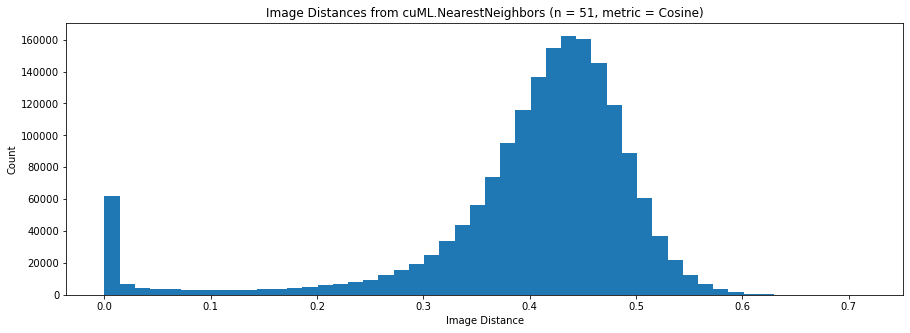

In [26]:
# Check distribution of image distances from cuML.NearestNeighbors (n = 51, metric = Cosine)
plt.figure(figsize=(15,5))
plt.hist(all_image_distances, bins = 50)
plt.xlabel('Image Distance (Cosine)')
plt.ylabel('Count')
plt.title('Image Distances from cuML.NearestNeighbors (n = 51, metric = Cosine)');

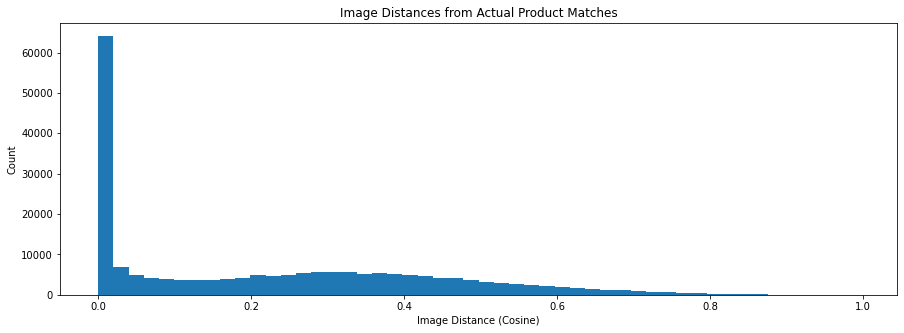

In [27]:
# Check distribution of actual matches image distances distribution
plt.figure(figsize=(15,5))
plt.hist(np.concatenate(actual_image_distances), bins = 50)
plt.xlabel('Image Distance (Cosine)')
plt.ylabel('Count')
plt.title('Image Distances from Actual Product Matches');

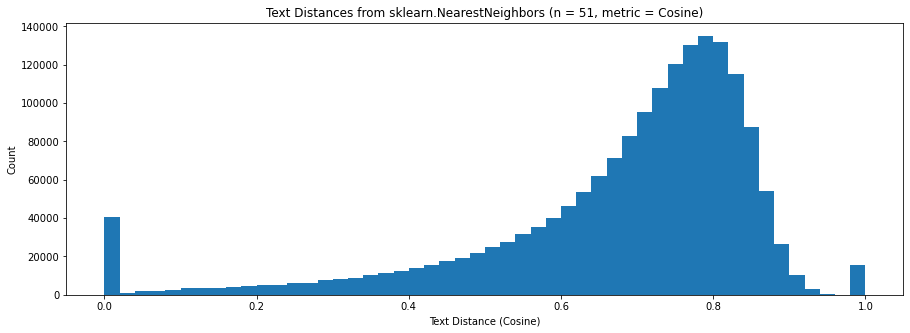

In [29]:
# Check distribution of text distances from sklearn.NearestNeighbors (n = 51, metric = Cosine)
plt.figure(figsize=(15,5))
plt.hist(all_text_distances, bins = 50)
plt.xlabel('Text Distance (Cosine)')
plt.ylabel('Count')
plt.title('Text Distances from sklearn.NearestNeighbors (n = 51, metric = Cosine)');

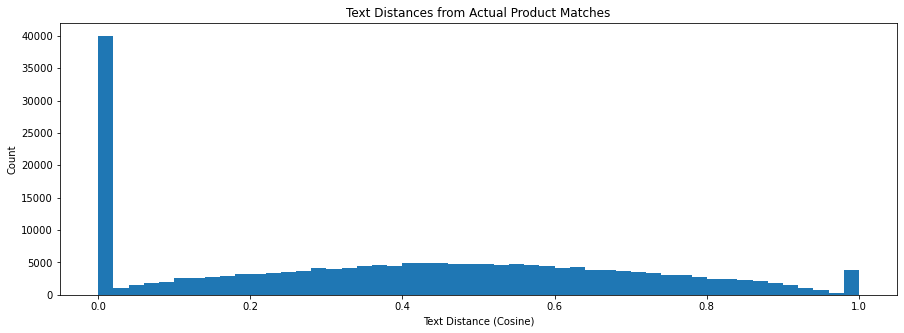

In [30]:
# Check distribution of actual matches text distances distribution
plt.figure(figsize=(15,5))
plt.hist(np.concatenate(actual_text_distances), bins = 50)
plt.xlabel('Text Distance (Cosine)')
plt.ylabel('Count')
plt.title('Text Distances from Actual Product Matches');

### F1 Scores = 1

In [31]:
view = ['posting_id', 'title', 'matches', 'combined_preds_0', 'combined_scores_0',
        'match_image_distances', 'match_text_distances', 'pred_image_distances', 'pred_text_distances',
        'pred_image_distances_avg', 'pred_text_distances_avg']

In [32]:
# Explore products with combined scores = 1
train.loc[train['combined_scores_0'] == 1][view].head(10)

,posting_id,title,matches,combined_preds_0,combined_scores_0,match_image_distances,match_text_distances,pred_image_distances,pred_text_distances,pred_image_distances_avg,pred_text_distances_avg
0,train_129225211,Paper Bag Victoria Secret,"[train_129225211, train_2278313361]","[train_129225211, train_2278313361]",1.0,"[0.0, 0.69]","[0.0, 0.0]","[0.0, 0.24, 0.24, 0.26, 0.28, 0.28, 0.28, 0.28...","[0.0, 0.0, 0.605, 0.638, 0.679, 0.682, 0.711, ...",0.30,0.737
2,train_2288590299,Maling TTS Canned Pork Luncheon Meat 397 gr,"[train_2288590299, train_3803689425]","[train_2288590299, train_3803689425]",1.0,"[0.0, 0.56]","[0.0, 0.338]","[-0.0, 0.36, 0.37, 0.42, 0.43, 0.43, 0.44, 0.4...","[0.0, 0.338, 0.79, 0.82, 0.827, 0.831, 0.842, ...",0.47,0.876
4,train_3369186413,Nescafe \xc3\x89clair Latte 220ml,"[train_3369186413, train_921438619]","[train_3369186413, train_921438619]",1.0,"[0.0, 0.12]","[0.0, 0.652]","[-0.0, 0.12, 0.32, 0.33, 0.42, 0.42, 0.42, 0.4...","[0.0, 0.652, 0.675, 0.74, 0.763, 0.763, 0.764,...",0.45,0.801
7,train_1806152124,KULOT PLISKET SALUR /CANDY PLISKET /WISH KULOT...,"[train_1806152124, train_3227306976]","[train_1806152124, train_3227306976]",1.0,"[0.0, 0.41]","[0.0, 0.425]","[0.0, 0.34, 0.35, 0.37, 0.37, 0.38, 0.38, 0.38...","[0.0, 0.425, 0.449, 0.47, 0.559, 0.575, 0.599,...",0.41,0.693
9,train_831680791,BIG SALE SEPATU PANTOFEL KULIT KEREN KERJA KAN...,"[train_831680791, train_3031035861]","[train_3031035861, train_831680791]",1.0,"[0.0, 0.07]","[0.0, 0.555]","[0.0, 0.07, 0.26, 0.29, 0.3, 0.3, 0.31, 0.31, ...","[0.0, 0.503, 0.516, 0.523, 0.553, 0.555, 0.571...",0.34,0.700
10,train_1598329973,Atasan Rajut Wanita LISDIA SWEATER,"[train_1598329973, train_841015183, train_4224...","[train_1598329973, train_4224502769, train_841...",1.0,"[0.0, 0.39, 0.39]","[0.0, 0.0, 0.082]","[0.0, 0.36, 0.37, 0.38, 0.38, 0.39, 0.39, 0.39...","[0.0, 0.0, 0.082, 0.486, 0.526, 0.549, 0.562, ...",0.40,0.604
11,train_2496690777,PASHMINA KUSUT RAWIS POLOS CRINKLE SHAWL MURAH...,"[train_2496690777, train_2771755203, train_163...","[train_1638187876, train_2496690777, train_277...",1.0,"[0.0, 0.0, 0.87]","[0.0, 0.043, 0.338]","[0.0, 0.0, 0.35, 0.4, 0.42, 0.42, 0.42, 0.42, ...","[0.0, 0.043, 0.338, 0.521, 0.562, 0.605, 0.617...",0.43,0.747
12,train_2771755203,PASHMINA KUSUT RAWIS POLOS CRINKLE SHAWL MURAH...,"[train_2496690777, train_2771755203, train_163...","[train_1638187876, train_2496690777, train_277...",1.0,"[0.0, 0.0, 0.87]","[0.043, 0.0, 0.366]","[0.0, 0.0, 0.35, 0.4, 0.42, 0.42, 0.42, 0.42, ...","[0.0, 0.043, 0.366, 0.494, 0.542, 0.622, 0.634...",0.43,0.740
13,train_998568945,Lampu led t5 Speedometer Dashboard Motor Mobil...,"[train_998568945, train_3118756415]","[train_3118756415, train_998568945]",1.0,"[0.0, 0.27]","[0.0, 0.417]","[0.0, 0.27, 0.29, 0.31, 0.34, 0.34, 0.34, 0.35...","[0.0, 0.417, 0.693, 0.693, 0.699, 0.7, 0.719, ...",0.38,0.763
14,train_4287573913,Charger VIZZ VZ-TC11 / batok charger vizz 1A O...,"[train_4287573913, train_1748125201, train_163...","[train_1633622311, train_1748125201, train_428...",1.0,"[0.0, 0.0, 0.0]","[0.0, 0.38, 0.366]","[-0.0, 0.0, 0.0, 0.29, 0.3, 0.3, 0.32, 0.34, 0...","[0.0, 0.366, 0.38, 0.605, 0.726, 0.729, 0.734,...",0.36,0.774


## Prediction Heuristics

Currently, the best image predictions use a fixed cosine distance threshold of 0.2333. The best text predictions use a fixed threshold of 0.4333.

Possible heuristics to combine image and text embeddings to improve predictions:

- Density based:
    - Set different distance thresholds for each product, based on the distances of the nearest neighbours. If the average distance of the nearest neighbours is smaller, use a smaller threshold.
- Sequential filtering:
    - Find similar images first, then find similar titles within these images
    - Find similar titles first, then find similar images within these titles
- Default to 1:
    - Most products are in pairs, and thus most predictions should be of size 2. If the nearest neighbour is above a certain threshold, meaning it is not similar enough, predict just 1 product (the product itself). This gives a default F1 score of 0.667 (predicting 1 out of 2) instead of a low score if too many products are predicted.
- Pair unpaired products:
    - If only 1 product is predicted (the product itself), there must be at least 1 other product that is the same because the minimum group size is 2. If only 1 product is predicted, try searching other predictions with only 1 product for a possible match (i.e. try to pair the predictions with only 1 product).

### Heuristic 1

Density-based distance heuristic:
- If the average image/text distance is lower, use a lower distance threshold
- If the average image/text distance is higher, use a higher distance threshold
- Set distance threshold to be a percentage of average image/text distance
- Use set union of final image/text predictions

In [33]:
# Check the average image distance of the 50 nearest image neighbours
np.mean([np.mean(i) for i in image_distances])

0.39890698

In [34]:
# Check the average text distance of the 50 nearest text neighbours
np.mean([np.mean(i) for i in text_distances])

0.678338417852965

In [35]:
# Check ratio of current fixed image threshold (0.2333) against average image distance
0.2333 / 0.39890698

0.5848481267487473

In [36]:
# Check ratio of current fixed text threshold (0.4333) against average text distance
0.4333 / 0.678338417852965

0.6387667108276935

In [37]:
# Set default image and text distance ratios
image_ratio = 0.58
text_ratio = 0.64

In [38]:
# Create function to predict based on image and text distances.
# Returns image predictions, text predictions and set union predictions
def predict_1(df, image_distances, image_indices, text_distances, text_indices, image_ratio, text_ratio):
    image_preds = []
    text_preds = []
    preds_union = []

    for i in range(df.shape[0]):
        
        # Set image threshold based on ratio of average image distance
        image_threshold = image_ratio * np.mean(image_distances[i])
        image_idx = image_indices[i][np.where(image_distances[i] <= image_threshold)]
        image_ids = df['posting_id'].iloc[image_idx].values
        image_preds.append(image_ids)
        
        # Set text threshold based on ratio of average text distance
        text_threshold = text_ratio * np.mean(text_distances[i])
        
        # Exclude text distances of 1 also
        text_idx = text_indices[i][(np.where((text_distances[i] <= text_threshold) & (text_distances[i] != 1)))]
        text_ids = df['posting_id'].iloc[text_idx].values
        text_preds.append(text_ids)
        
        preds_union.append(np.union1d(image_ids, text_ids))

    return image_preds, text_preds, preds_union

In [39]:
# Create predictions from default image and text distance ratios
image_preds_1, text_preds_1, preds_union_1 = predict_1(train, image_distances, image_indices, text_distances, text_indices, image_ratio, text_ratio)

In [40]:
matches = list(train['matches'].to_numpy())

In [41]:
# Check average F1 score of image predictions from default ratios
np.mean(scores(matches, image_preds_1))

0.7114339775022952

In [42]:
# Check average F1 score of text predictions from default ratios
np.mean(scores(matches, text_preds_1))

0.6585770734299018

In [43]:
# Check average F1 score of set union predictions from default ratios
np.mean(scores(matches, preds_union_1))

0.7627802848312543

In [44]:
# Grid search various image and text ratios
image_ratios = [0.5, 0.52, 0.54, 0.56, 0.58, 0.60, 0.62, 0.64, 0.66]
text_ratios = [0.56, 0.58, 0.60, 0.62, 0.64, 0.66, 0.68, 0.7, 0.72]

for image_ratio in image_ratios:
    for text_ratio in text_ratios:
        image_preds_search, text_preds_search, preds_union_search = predict_1(train, image_distances, image_indices, 
                                                                              text_distances, text_indices, 
                                                                              image_ratio, text_ratio)
        print(f'At image ratio {image_ratio} and text ratio {text_ratio}:')
        print(f'average image prediction score is {np.mean(scores(matches, image_preds_search))}')
        print(f'average text prediction score is {np.mean(scores(matches, text_preds_search))}')
        print(f'average union prediction score is {np.mean(scores(matches, preds_union_search))}')

At image ratio 0.5 and text ratio 0.56:
average image prediction score is 0.699230930354907
average text prediction score is 0.6489236970254032
average union prediction score is 0.7691454244482542
At image ratio 0.5 and text ratio 0.58:
average image prediction score is 0.699230930354907
average text prediction score is 0.6530478680626024
average union prediction score is 0.7685488733249651
At image ratio 0.5 and text ratio 0.6:
average image prediction score is 0.699230930354907
average text prediction score is 0.6555280834254488
average union prediction score is 0.7665878485461073
At image ratio 0.5 and text ratio 0.62:
average image prediction score is 0.699230930354907
average text prediction score is 0.6572090003178892
average union prediction score is 0.7638249524392863
At image ratio 0.5 and text ratio 0.64:
average image prediction score is 0.699230930354907
average text prediction score is 0.6585770734299018
average union prediction score is 0.7604379885066649
At image ratio 0

average text prediction score is 0.659044277161936
average union prediction score is 0.758371912085487
At image ratio 0.58 and text ratio 0.68:
average image prediction score is 0.7114339775022952
average text prediction score is 0.6580662129710481
average union prediction score is 0.7529520590450712
At image ratio 0.58 and text ratio 0.7:
average image prediction score is 0.7114339775022952
average text prediction score is 0.6565274272961589
average union prediction score is 0.7467169032872394
At image ratio 0.58 and text ratio 0.72:
average image prediction score is 0.7114339775022952
average text prediction score is 0.6535820661772423
average union prediction score is 0.7390089585121363
At image ratio 0.6 and text ratio 0.56:
average image prediction score is 0.7140261086113819
average text prediction score is 0.6489236970254032
average union prediction score is 0.7727230021025251
At image ratio 0.6 and text ratio 0.58:
average image prediction score is 0.7140261086113819
average te

In [45]:
# Best combination: image ratio 0.62 and text ratio 0.56 gives score of 0.772868470305518
# Create predictions from best image and text distance ratios
image_preds_1, text_preds_1, preds_union_1 = predict_1(train, image_distances, image_indices, text_distances, text_indices,
                                                       0.62, 0.56)

In [73]:
# Save best results to df
train['best_image_preds_1'] = image_preds_1
train['best_image_scores_1'] = scores(matches,image_preds_1)

train['best_text_preds_1'] = text_preds_1
train['best_text_scores_1'] = scores(matches,text_preds_1)

train['combined_preds_1'] = preds_union_1
train['combined_scores_1'] = scores(matches,preds_union_1)

In [74]:
# Save combined train dataset as npy
np.save('../datasets/train_combined.npy', train.to_numpy())

In [75]:
# Print columns for reloading np file
print(train.columns)

Index(['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches',
       'image_duplicates', 'best_image_preds_0', 'best_image_scores_0',
       'best_text_preds_0', 'best_text_scores_0', 'combined_preds_0',
       'combined_scores_0', 'match_image_distances', 'match_text_distances',
       'pred_image_distances', 'pred_text_distances',
       'pred_image_distances_avg', 'pred_text_distances_avg',
       'best_image_preds_1', 'best_image_scores_1', 'best_text_preds_1',
       'best_text_scores_1', 'combined_preds_1', 'combined_scores_1'],
      dtype='object')


## Scores and Results

### Distribution of F1 Scores

In [76]:
# Load combined train df
train = pd.DataFrame(np.load('../datasets/train_combined.npy', allow_pickle=True),
                      columns=['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches',
                               'image_duplicates', 'best_image_preds_0', 'best_image_scores_0',
                               'best_text_preds_0', 'best_text_scores_0', 'combined_preds_0',
                               'combined_scores_0', 'match_image_distances', 'match_text_distances',
                               'pred_image_distances', 'pred_text_distances',
                               'pred_image_distances_avg', 'pred_text_distances_avg',
                               'best_image_preds_1', 'best_image_scores_1', 'best_text_preds_1',
                               'best_text_scores_1', 'combined_preds_1', 'combined_scores_1'])

In [77]:
train.head()

,posting_id,image,image_phash,title,label_group,matches,image_duplicates,best_image_preds_0,best_image_scores_0,best_text_preds_0,...,pred_image_distances,pred_text_distances,pred_image_distances_avg,pred_text_distances_avg,best_image_preds_1,best_image_scores_1,best_text_preds_1,best_text_scores_1,combined_preds_1,combined_scores_1
0,train_129225211,0000a68812bc7e98c42888dfb1c07da0.jpg,94974f937d4c2433,Paper Bag Victoria Secret,249114794,"[train_129225211, train_2278313361]",[train_129225211],[train_129225211],0.666667,"[train_129225211, train_2278313361]",...,"[0.0, 0.24, 0.24, 0.26, 0.28, 0.28, 0.28, 0.28...","[0.0, 0.0, 0.605, 0.638, 0.679, 0.682, 0.711, ...",0.3,0.737,[train_129225211],0.666667,"[train_129225211, train_2278313361]",1.0,"[train_129225211, train_2278313361]",1.0
1,train_3386243561,00039780dfc94d01db8676fe789ecd05.jpg,af3f9460c2838f0f,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...",2937985045,"[train_3386243561, train_3423213080]",[train_3386243561],"[train_3386243561, train_3423213080, train_212...",0.5,"[train_3386243561, train_3423213080, train_197...",...,"[0.0, 0.16, 0.18, 0.19, 0.22, 0.23, 0.26, 0.27...","[0.0, 0.391, 0.402, 0.402, 0.402, 0.411, 0.457...",0.37,0.63,"[train_3386243561, train_3423213080, train_212...",0.5,[train_3386243561],0.666667,"[train_1816968361, train_2120597446, train_250...",0.5
2,train_2288590299,000a190fdd715a2a36faed16e2c65df7.jpg,b94cb00ed3e50f78,Maling TTS Canned Pork Luncheon Meat 397 gr,2395904891,"[train_2288590299, train_3803689425]",[train_2288590299],[train_2288590299],0.666667,"[train_2288590299, train_3803689425]",...,"[-0.0, 0.36, 0.37, 0.42, 0.43, 0.43, 0.44, 0.4...","[0.0, 0.338, 0.79, 0.82, 0.827, 0.831, 0.842, ...",0.47,0.876,[train_2288590299],0.666667,"[train_2288590299, train_3803689425]",1.0,"[train_2288590299, train_3803689425]",1.0
3,train_2406599165,00117e4fc239b1b641ff08340b429633.jpg,8514fc58eafea283,Daster Batik Lengan pendek - Motif Acak / Camp...,4093212188,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_2406599165, train_1593362411, train_280...",0.333333,"[train_1744956981, train_2406599165, train_352...",...,"[0.0, 0.14, 0.22, 0.22, 0.26, 0.27, 0.27, 0.29...","[0.0, 0.0, 0.087, 0.112, 0.212, 0.355, 0.416, ...",0.3,0.656,"[train_2406599165, train_1593362411]",0.5,"[train_1744956981, train_2406599165, train_352...",0.25,"[train_1508100548, train_1593362411, train_174...",0.222222
4,train_3369186413,00136d1cf4edede0203f32f05f660588.jpg,a6f319f924ad708c,Nescafe \xc3\x89clair Latte 220ml,3648931069,"[train_3369186413, train_921438619]",[train_3369186413],"[train_3369186413, train_921438619]",1.0,[train_3369186413],...,"[-0.0, 0.12, 0.32, 0.33, 0.42, 0.42, 0.42, 0.4...","[0.0, 0.652, 0.675, 0.74, 0.763, 0.763, 0.764,...",0.45,0.801,"[train_3369186413, train_921438619]",1.0,[train_3369186413],0.666667,"[train_3369186413, train_921438619]",1.0


In [78]:
# Combined models to examine
models = [0, 1]

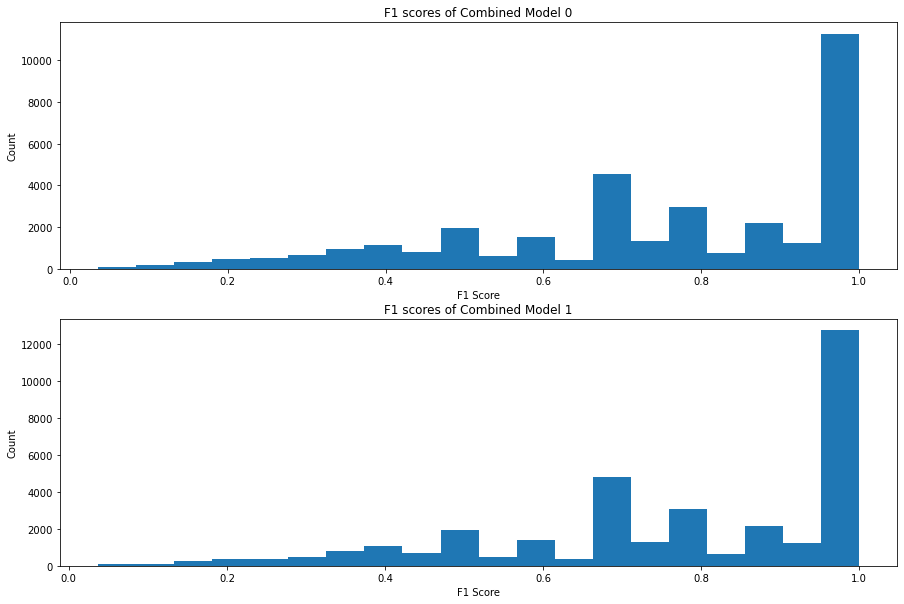

In [79]:
# Check distribution of F1 scores
plt.figure(figsize=(15,5*len(models)))

for i in range(len(models)):
    plt.subplot(len(models), 1, i + 1)
    plt.hist(train[f'combined_scores_{models[i]}'], bins=20)
    plt.ylabel('Count')
    plt.xlabel('F1 Score')
    plt.title(f'F1 scores of Combined Model {models[i]}')

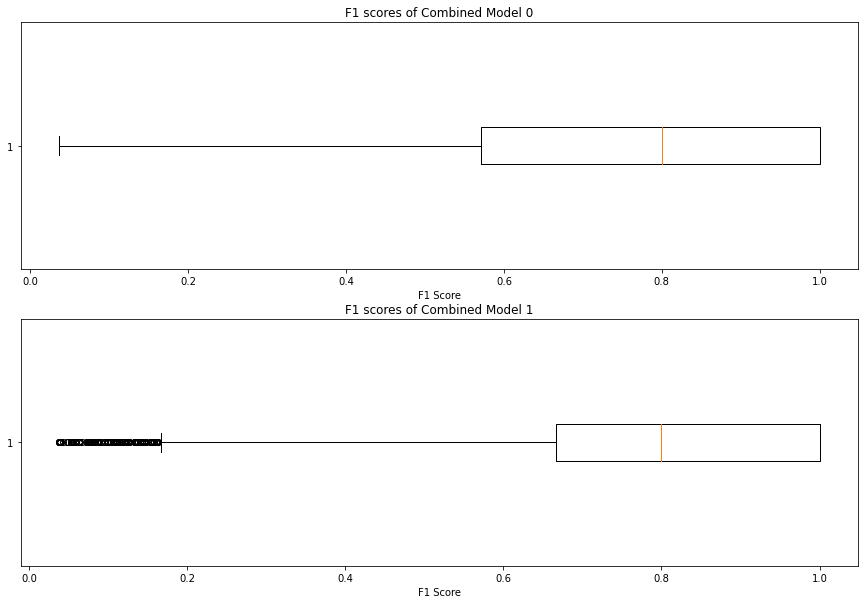

In [80]:
# Check distribution of F1 scores
plt.figure(figsize=(15,5*len(models)))

for i in range(len(models)):
    plt.subplot(len(models), 1, i + 1)
    plt.boxplot(train[f'combined_scores_{models[i]}'], vert=False)
    plt.xlabel('F1 Score')
    plt.title(f'F1 scores of Combined Model {models[i]}');

In [81]:
# Check F1 score value counts
for i in range(len(models)):
    print(f'Most frequent F1 score of combined model {models[i]}')
    print(train[f'combined_scores_{models[i]}'].value_counts().head(10))
    print('')

Most frequent F1 score of combined model 0
1.000000    10857
0.666667     4245
0.800000     2442
0.500000     1784
0.857143     1039
0.571429      977
0.400000      918
0.750000      671
0.888889      645
0.333333      539
Name: combined_scores_0, dtype: int64

Most frequent F1 score of combined model 1
1.000000    12405
0.666667     4608
0.800000     2696
0.500000     1759
0.857143     1060
0.571429      898
0.400000      875
0.750000      718
0.888889      690
0.333333      525
Name: combined_scores_1, dtype: int64



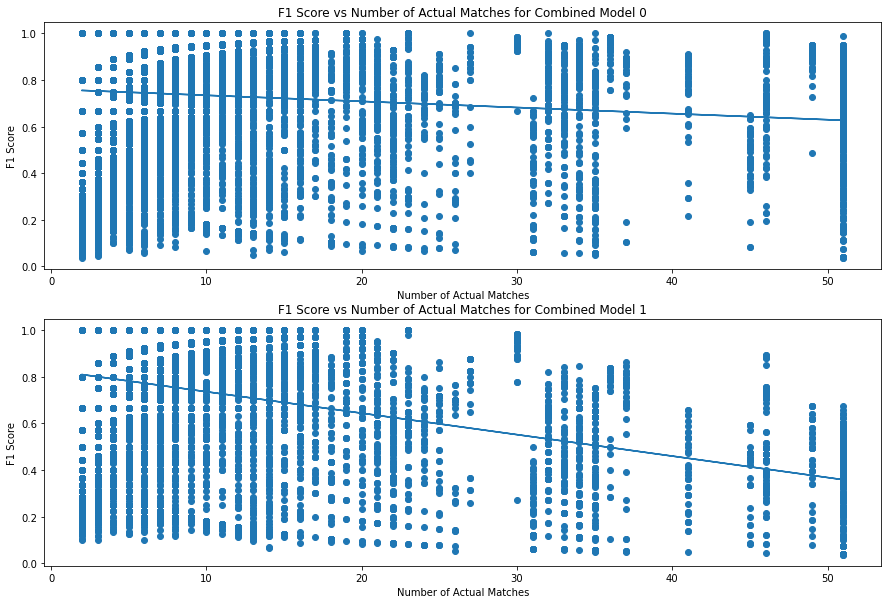

In [82]:
# Check F1 scores by number of matches
plt.figure(figsize = (15,5*len(models)))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Number of Actual Matches')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Number of Actual Matches for Combined Model {models[i]}');

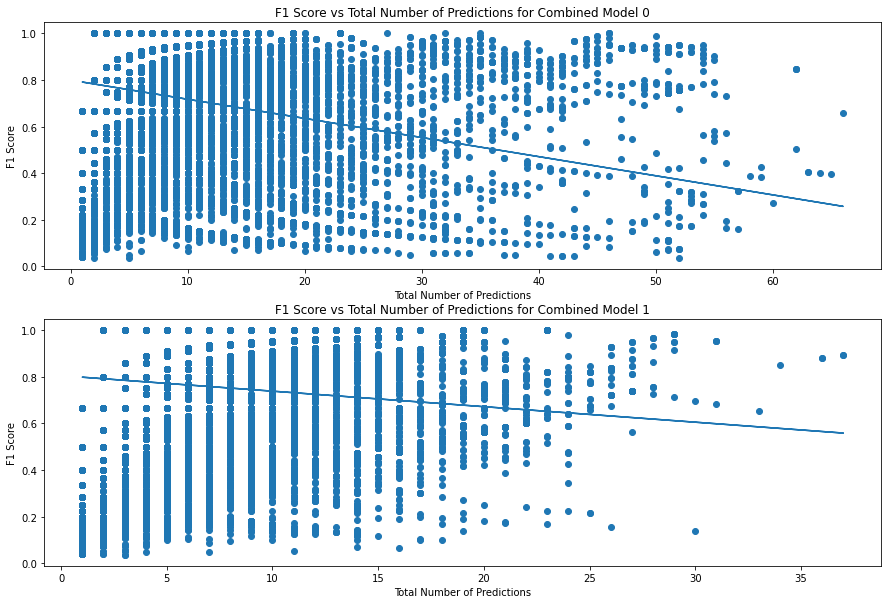

In [83]:
# Check F1 scores by number of predictions
plt.figure(figsize = (15,5*len(models)))

for i in range(len(models)):
    x = [len(pred) for pred in train[f'combined_preds_{models[i]}']]
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Total Number of Predictions')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Total Number of Predictions for Combined Model {models[i]}');

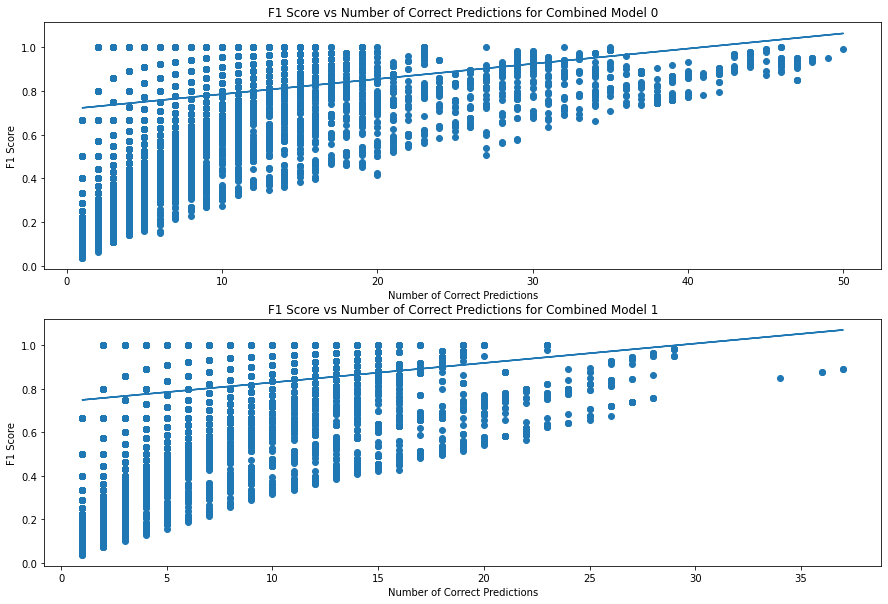

In [84]:
# Check F1 scores by number of correct predictions
plt.figure(figsize = (15,5*len(models)))

for i in range(len(models)):
    x = []
    for j in range(len(train['matches'])):
        x.append(len(np.intersect1d(train['matches'][j], train[f'combined_preds_{models[i]}'][j])))
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Number of Correct Predictions')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Number of Correct Predictions for Combined Model {models[i]}');

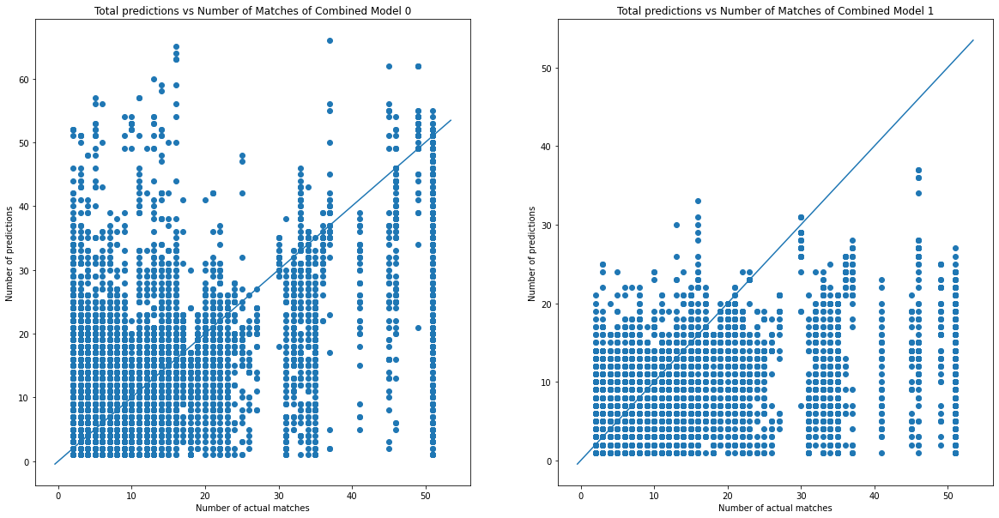

In [85]:
# Check number of predictions vs number of matches
plt.figure(figsize=(20,10))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = [len(pred) for pred in train[f'combined_preds_{models[i]}']]
    plt.subplot(1,2,i+1)
    plt.scatter(x, y)
    xpoints = ypoints = plt.xlim()
    plt.plot(xpoints, ypoints)
    plt.xlabel('Number of actual matches')
    plt.ylabel('Number of predictions')
    plt.title(f'Total predictions vs Number of Matches of Combined Model {models[i]}');

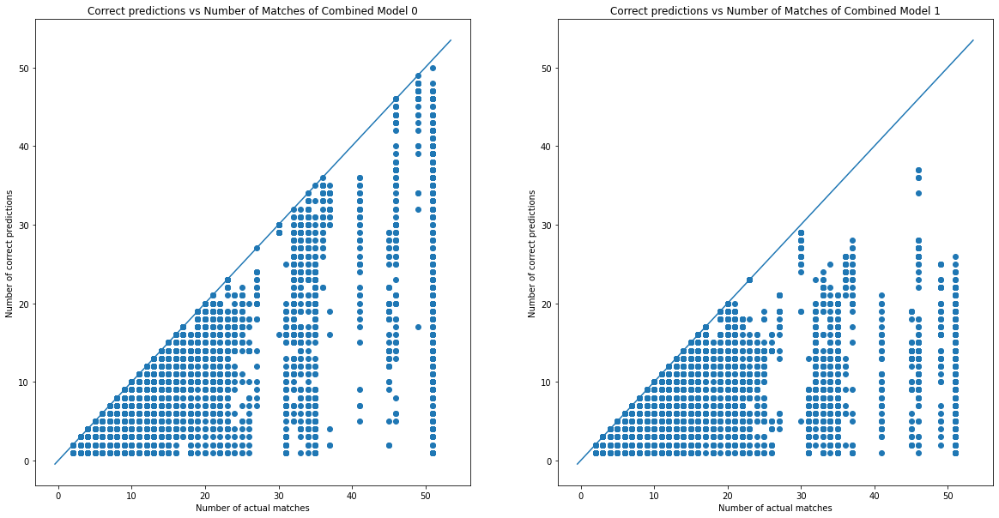

In [86]:
# Check number of correct predictions vs number of matches
plt.figure(figsize=(20,10))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = []
    for j in range(len(train['matches'])):
        y.append(len(np.intersect1d(train['matches'][j], train[f'combined_preds_{models[i]}'][j])))
    plt.subplot(1,2,i+1)
    plt.scatter(x, y)
    xpoints = ypoints = plt.xlim()
    plt.plot(xpoints, ypoints)
    plt.xlabel('Number of actual matches')
    plt.ylabel('Number of correct predictions')
    plt.title(f'Correct predictions vs Number of Matches of Combined Model {models[i]}');

### Combined Predictions vs Image/Text Predictions

In [87]:
# Create function to compare combined predictions vs image / text predictions alone
def compare(df, model):
    comparisons = []
    
    for i in range(train.shape[0]):
        if (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_image_scores_{model}'].iloc[i]) and \
           (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_text_scores_{model}'].iloc[i]):
            comparisons.append('combined better than / equal to image and text')

        elif (train[f'combined_scores_{model}'].iloc[i] < train[f'best_image_scores_{model}'].iloc[i]) and \
             (train[f'combined_scores_{model}'].iloc[i] < train[f'best_text_scores_{model}'].iloc[i]):
            comparisons.append('combined worse than image and text')

        elif (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_image_scores_{model}'].iloc[i]) and \
             (train[f'combined_scores_{model}'].iloc[i] < train[f'best_text_scores_{model}'].iloc[i]):
            comparisons.append('combined better than / equal to image but worse than text')

        elif (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_text_scores_{model}'].iloc[i]) and \
             (train[f'combined_scores_{model}'].iloc[i] < train[f'best_image_scores_{model}'].iloc[i]):
            comparisons.append('combined better than / equal to text but worse than image')
    
    return comparisons

In [88]:
# Check comparisons for model 0
nltk.FreqDist(compare(train, model=0)).most_common()

[('combined better than / equal to image and text', 23421),
 ('combined better than / equal to text but worse than image', 8031),
 ('combined better than / equal to image but worse than text', 1951),
 ('combined worse than image and text', 847)]

In [89]:
# Check comparisons for model 1
nltk.FreqDist(compare(train, model=1)).most_common()

[('combined better than / equal to image and text', 26250),
 ('combined better than / equal to text but worse than image', 5251),
 ('combined better than / equal to image but worse than text', 2178),
 ('combined worse than image and text', 571)]

Set union of best image and text predictions generally improves or retains the image/text scores.

However, some scores were lower after using the set union. In particular, some set union scores were lower than the image scores.

### Image and Title Predictions vs Matches

In [90]:
# Create function to plot images of matches or combined predictions
def show_images_combined(df, posting_id, model=0, matches=True, columns=3, width=30, height=10):
    
    # If we are checking for matching images
    if matches:
        group = df.loc[df['posting_id'] == posting_id]['matches'].values[0]

    # If we are checking our combined predictions
    else:
        group = df.loc[df['posting_id'] == posting_id][f'combined_preds_{model}'].values[0]

    height = max(height, int(len(group)/columns) * height)
    plt.figure(figsize=(width, height))

    for i in range(len(group)):
        plt.subplot(len(group) // columns + 1, columns, i + 1)
        im = Image.open(train_dir + df.loc[df['posting_id'] == group[i]]['image'].values[0])
        plt.imshow(im)
        plt.title(df.loc[df['posting_id'] == group[i]]['title'].values[0])

In [91]:
view = ['posting_id', 'title', 'matches', 'image_duplicates',
        'combined_preds_0', 'combined_scores_0',
        'combined_preds_1', 'combined_scores_1']

#### Model 1 > Model 0

In [92]:
# Check predictions where model 1 is better than model 0
train.loc[train['combined_scores_0'] < train['combined_scores_1']][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
1,train_3386243561,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...","[train_3386243561, train_3423213080]",[train_3386243561],"[train_1816968361, train_1974987067, train_211...",0.333333,"[train_1816968361, train_2120597446, train_250...",0.5
3,train_2406599165,Daster Batik Lengan pendek - Motif Acak / Camp...,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_1508100548, train_1593362411, train_174...",0.166667,"[train_1508100548, train_1593362411, train_174...",0.222222
16,train_3009013664,MARKS & SPENCER - Rose Hand & Body Lotion 250 ml,"[train_3009013664, train_3448377589]",[train_3009013664],"[train_1248209230, train_2047191940, train_236...",0.5,"[train_1248209230, train_236461645, train_3009...",0.571429
18,train_2985955659,HnKfashion Sweater Hoodie WHO Printing BabyTer...,"[train_2985955659, train_3916258742, train_415...",[train_2985955659],"[train_1156173438, train_2069761199, train_298...",0.75,"[train_2985955659, train_3916258742, train_415...",1.0
26,train_2905529497,Masker Medis 3ply Earloop (50pcs) - Masker 3pl...,"[train_2905529497, train_869563964]",[train_2905529497],"[train_109788017, train_1166693195, train_1782...",0.181818,"[train_2905529497, train_856120369]",0.5


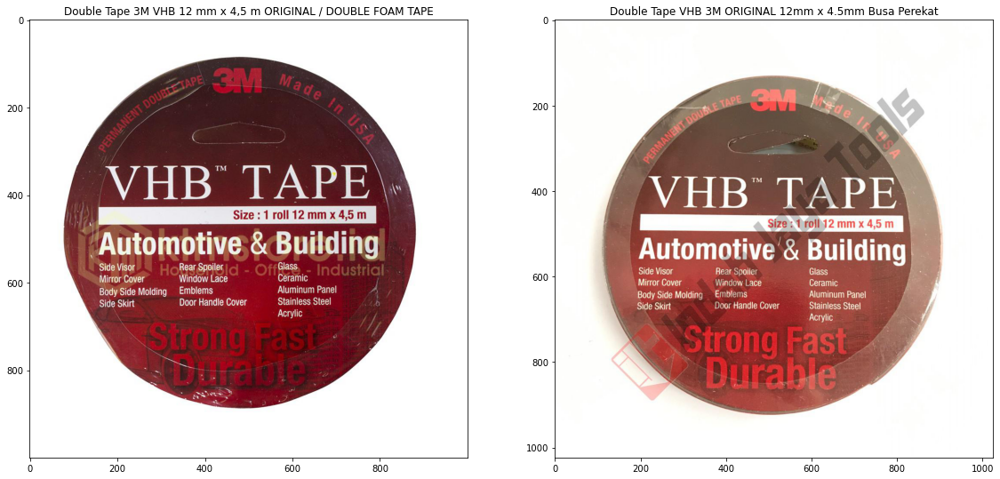

In [93]:
# Show matching images and titles of 'train_3386243561'
show_images_combined(train, 'train_3386243561', matches=True)

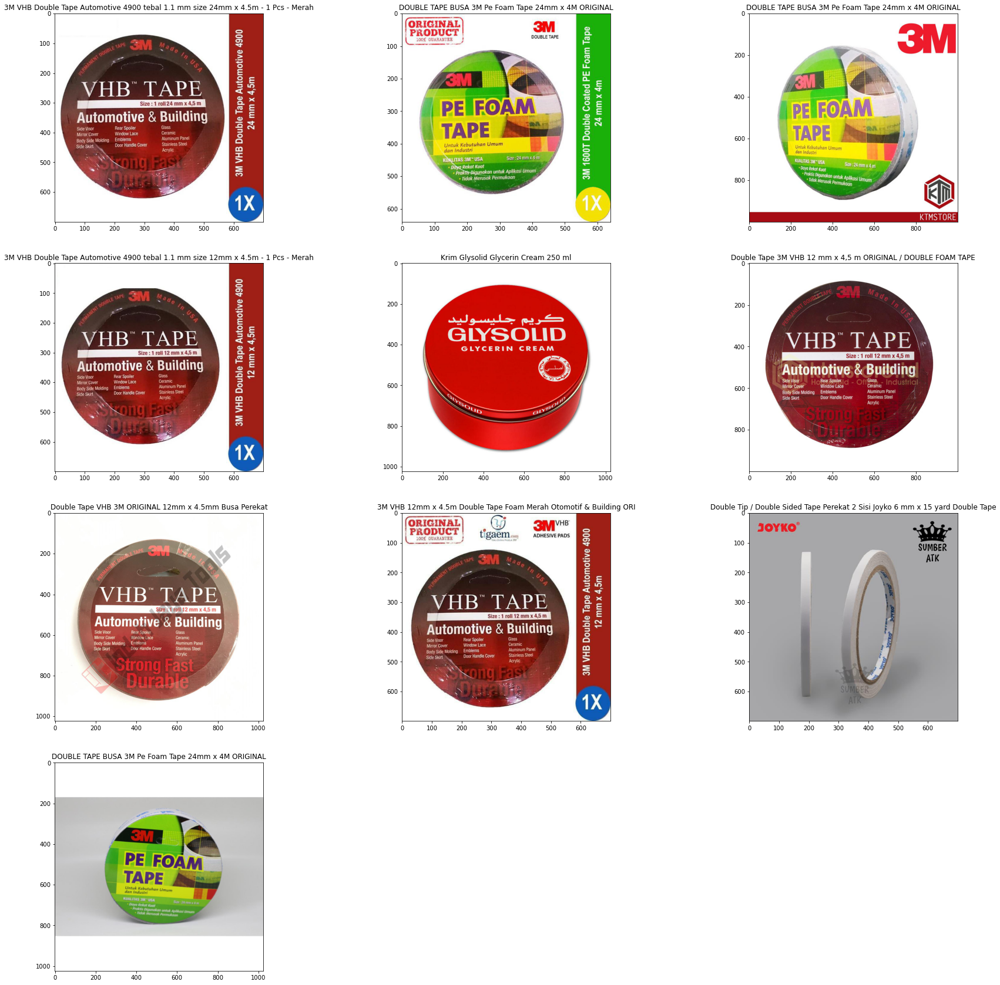

In [94]:
# Show predicted images and titles of 'train_3386243561' from model 0
show_images_combined(train, 'train_3386243561', model=0, matches=False)

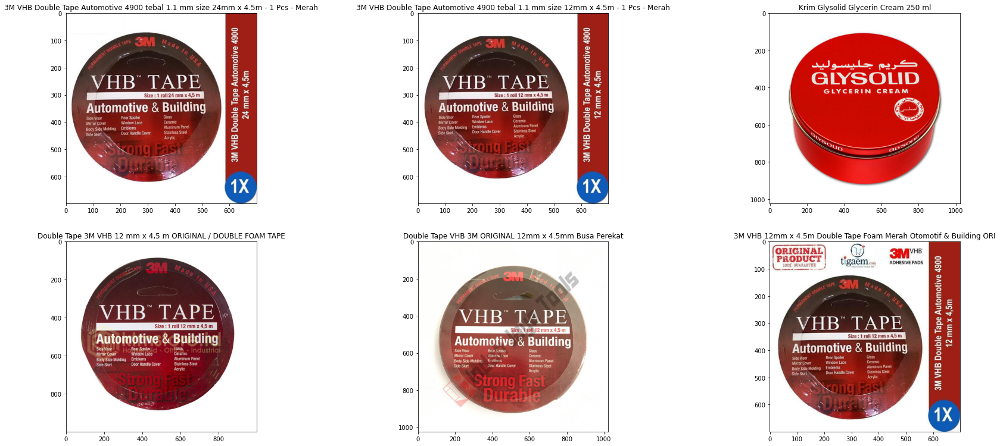

In [95]:
# Show predicted images and titles of 'train_3386243561' from model 1
show_images_combined(train, 'train_3386243561', model=1, matches=False)

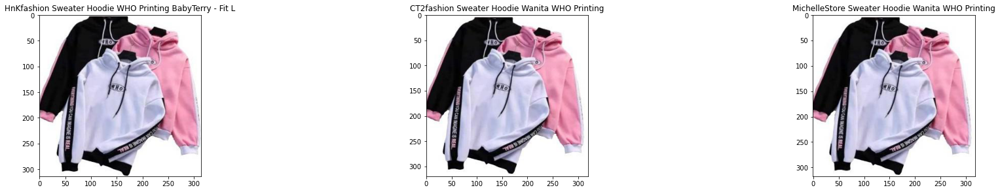

In [96]:
# Show matching images and titles of 'train_2985955659'
show_images_combined(train, 'train_2985955659', matches=True)

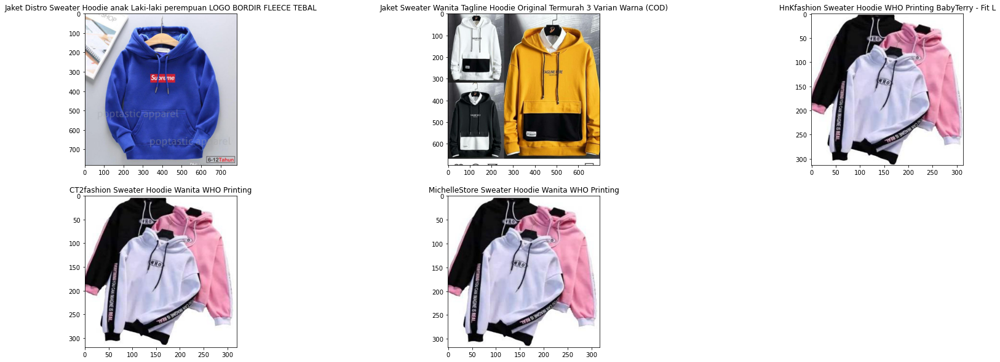

In [97]:
# Show predicted images and titles of 'train_2985955659' from model 0
show_images_combined(train, 'train_2985955659', model=0, matches=False)

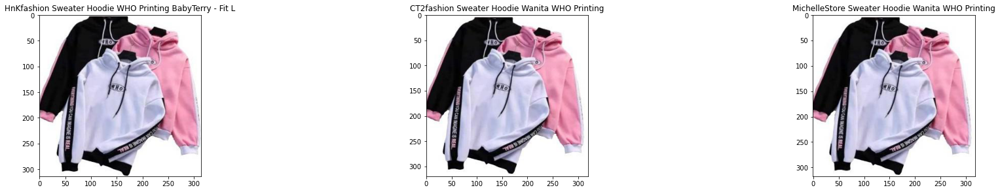

In [98]:
# Show predicted images and titles of 'train_2985955659' from model 1
show_images_combined(train, 'train_2985955659', model=1, matches=False)

#### F1 Scores < 0.66

F1 scores of 1.0, 0.667 and 0.8 are most common. Examine images / titles of predictions with scores < 0.66.

In [99]:
# Check predictions where model 0 and model 1 < 0.66
train.loc[((train['combined_scores_0'] < 0.66) & (train['combined_scores_1'] < 0.66))][view].head(10)

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
1,train_3386243561,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...","[train_3386243561, train_3423213080]",[train_3386243561],"[train_1816968361, train_1974987067, train_211...",0.333333,"[train_1816968361, train_2120597446, train_250...",0.5
3,train_2406599165,Daster Batik Lengan pendek - Motif Acak / Camp...,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_1508100548, train_1593362411, train_174...",0.166667,"[train_1508100548, train_1593362411, train_174...",0.222222
6,train_1802986387,Jubah anak size 1-12 thn,"[train_1802986387, train_1396161074, train_713...",[train_1802986387],"[train_1396161074, train_1513994777, train_180...",0.545455,"[train_1396161074, train_1802986387]",0.444444
15,train_4196427721,Korek Kuping LED untuk balita CherryBabyKidsSh...,"[train_4196427721, train_1482447822, train_234...","[train_4196427721, train_2221959828, train_375...","[train_2221959828, train_3757879175, train_419...",0.545455,"[train_2221959828, train_3757879175, train_419...",0.5
16,train_3009013664,MARKS & SPENCER - Rose Hand & Body Lotion 250 ml,"[train_3009013664, train_3448377589]",[train_3009013664],"[train_1248209230, train_2047191940, train_236...",0.5,"[train_1248209230, train_236461645, train_3009...",0.571429
24,train_1872347548,Stand Hanger Multifungsi - Tiang Gantungan Baj...,"[train_1872347548, train_998519723, train_1760...",[train_1872347548],"[train_1872347548, train_2368264311, train_263...",0.6,"[train_1872347548, train_2638227964, train_998...",0.6
26,train_2905529497,Masker Medis 3ply Earloop (50pcs) - Masker 3pl...,"[train_2905529497, train_869563964]",[train_2905529497],"[train_109788017, train_1166693195, train_1782...",0.181818,"[train_2905529497, train_856120369]",0.5
30,train_1617041019,Molina Kaftan / YADITA SPARKLE KAFTAN / KEANU ...,"[train_1617041019, train_2772927896]",[train_1617041019],"[train_1210102540, train_1617041019, train_176...",0.5,"[train_1210102540, train_1617041019, train_176...",0.5
31,train_2410183091,B33F My Food Shop Shopping Trolley - ST. 003 t...,"[train_2410183091, train_2529718493, train_304...",[train_2410183091],"[train_143394667, train_1504499709, train_2410...",0.571429,"[train_143394667, train_1504499709, train_2410...",0.571429
35,train_1640409557,CHIL KID GOLD VANILA 800GR,"[train_1640409557, train_2613418854, train_104...",[train_1640409557],"[train_1047742962, train_1213287531, train_164...",0.375,"[train_1047742962, train_1640409557, train_206...",0.6


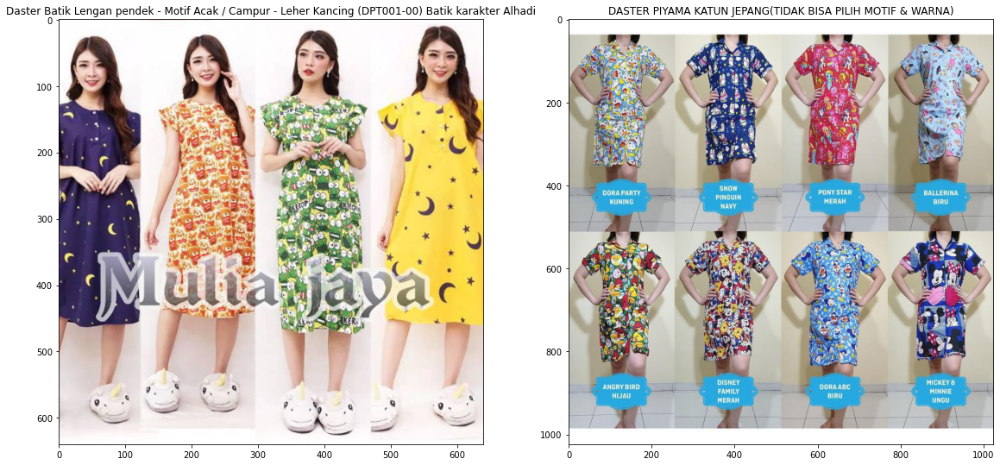

In [100]:
# Show matching images and titles of 'train_2406599165'
show_images_combined(train, 'train_2406599165', matches=True)

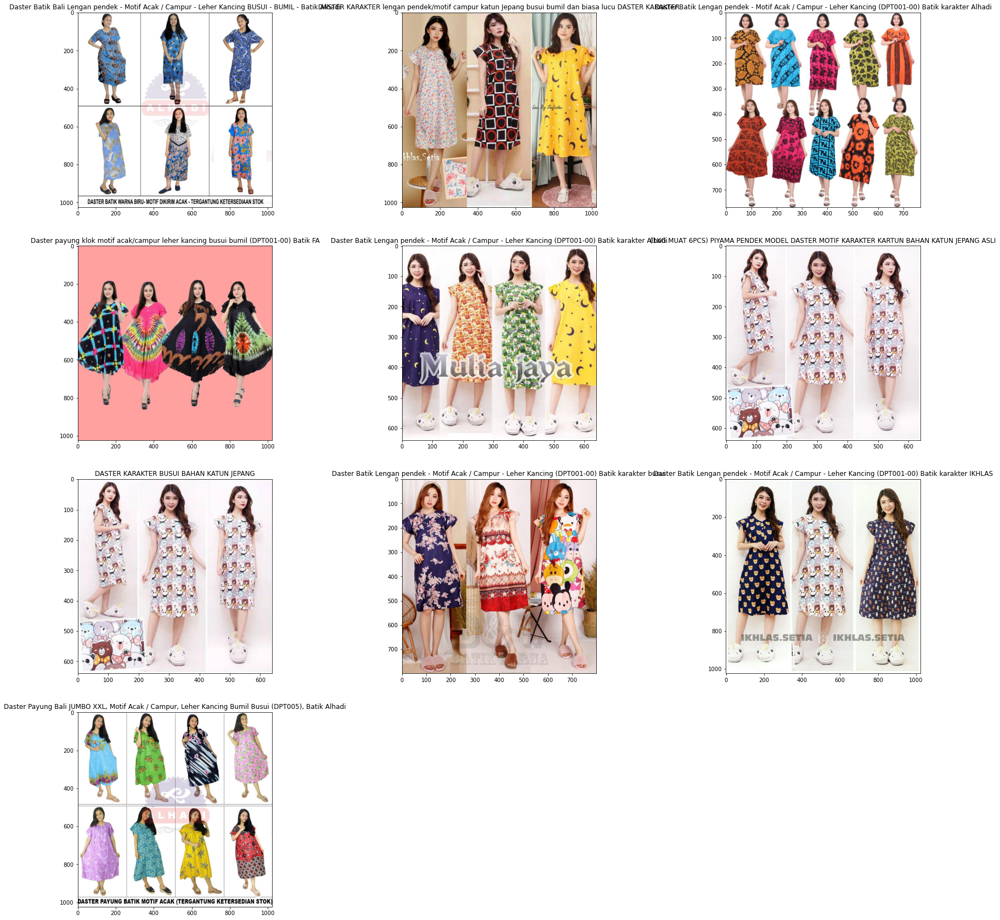

In [101]:
# Show predicted images and titles of 'train_2406599165' from model 0
show_images_combined(train, 'train_2406599165', model=0, matches=False)

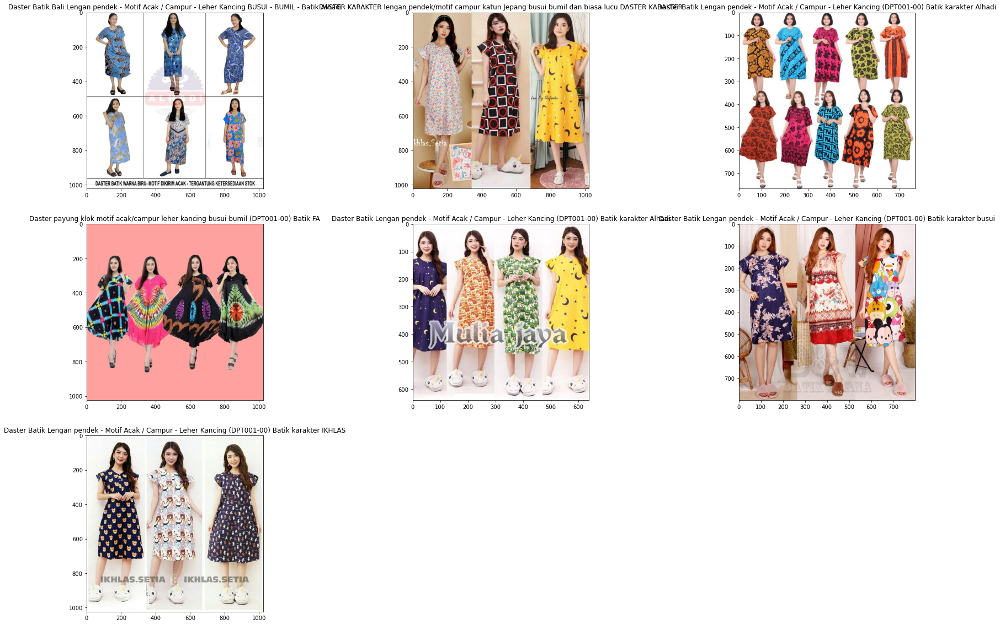

In [102]:
# Show predicted images and titles of 'train_2406599165' from model 1
show_images_combined(train, 'train_2406599165', model=1, matches=False)

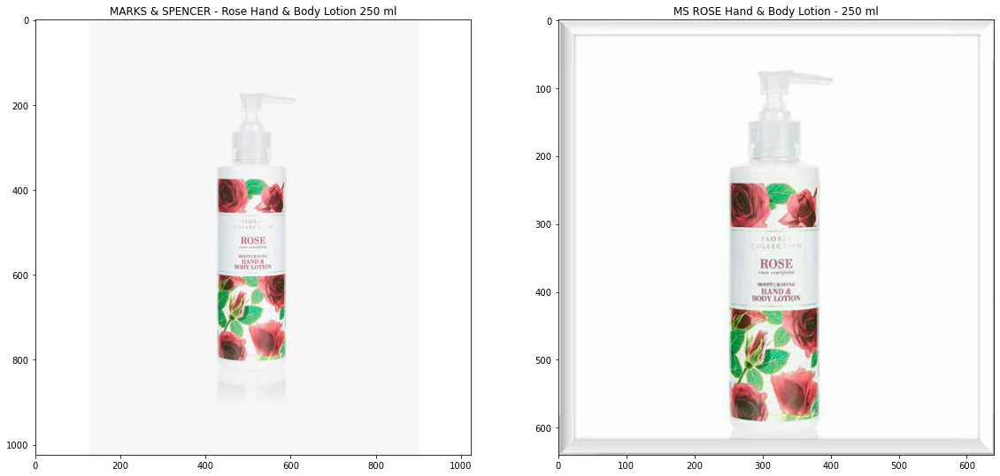

In [103]:
# Show matching images and titles of 'train_3009013664'
show_images_combined(train, 'train_3009013664', matches=True)

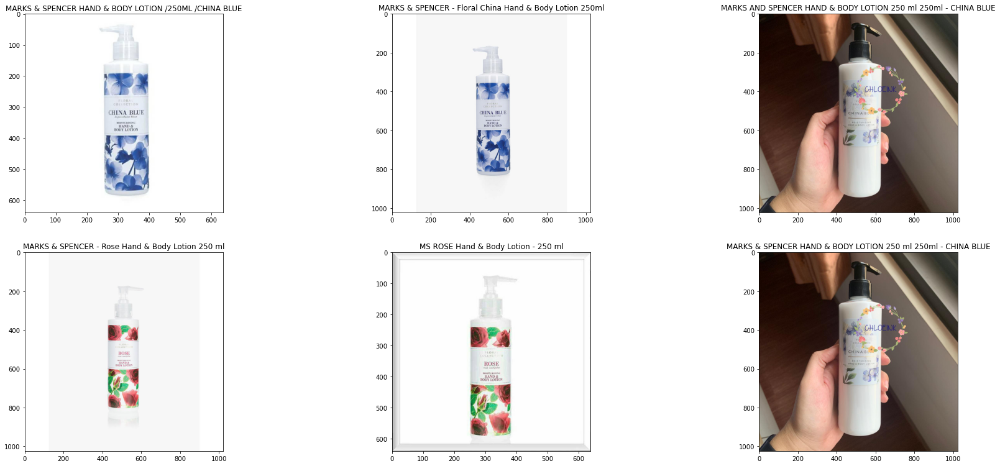

In [104]:
# Show predicted images and titles of 'train_3009013664' from model 0
show_images_combined(train, 'train_3009013664', model=0, matches=False)

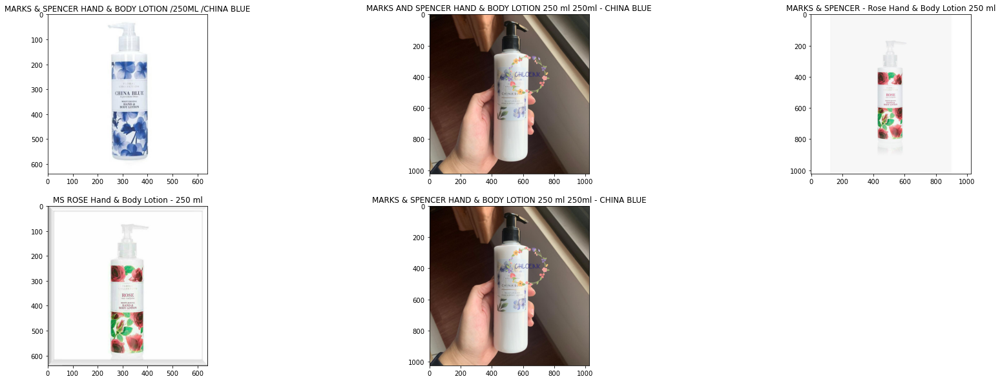

In [105]:
# Show predicted images and titles of 'train_3009013664' from model 1
show_images_combined(train, 'train_3009013664', model=1, matches=False)

#### Set Union Scores < Best Image Scores

There are some products where the set union scores are lower compared to the best image scores.

Examine these images / titles to see how we may retain the higher image scores.

In [106]:
# Locate predictions where set union is better than / equal to text but worse than image
train.loc[((train['combined_scores_0'] < train['best_image_scores_0']) & (train['combined_scores_0'] >= train['best_text_scores_0']) & \
           (train['combined_scores_1'] < train['best_image_scores_1']) & (train['combined_scores_1'] >= train['best_text_scores_1']))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
8,train_86570404,"[LOGU] Tempelan kulkas magnet angka, tempelan ...","[train_86570404, train_2837452969, train_77364...",[train_86570404],"[train_115157077, train_2269068443, train_2837...",0.75,"[train_115157077, train_2269068443, train_2837...",0.75
16,train_3009013664,MARKS & SPENCER - Rose Hand & Body Lotion 250 ml,"[train_3009013664, train_3448377589]",[train_3009013664],"[train_1248209230, train_2047191940, train_236...",0.5,"[train_1248209230, train_236461645, train_3009...",0.571429
26,train_2905529497,Masker Medis 3ply Earloop (50pcs) - Masker 3pl...,"[train_2905529497, train_869563964]",[train_2905529497],"[train_109788017, train_1166693195, train_1782...",0.181818,"[train_2905529497, train_856120369]",0.5
30,train_1617041019,Molina Kaftan / YADITA SPARKLE KAFTAN / KEANU ...,"[train_1617041019, train_2772927896]",[train_1617041019],"[train_1210102540, train_1617041019, train_176...",0.5,"[train_1210102540, train_1617041019, train_176...",0.5
32,train_1461445798,Alat Facial Wajah 5 in 1 / Face Beauty Care Ma...,"[train_1461445798, train_1749322479]",[train_1461445798],"[train_1461445798, train_1749322479, train_318...",0.666667,"[train_1461445798, train_1749322479, train_318...",0.8


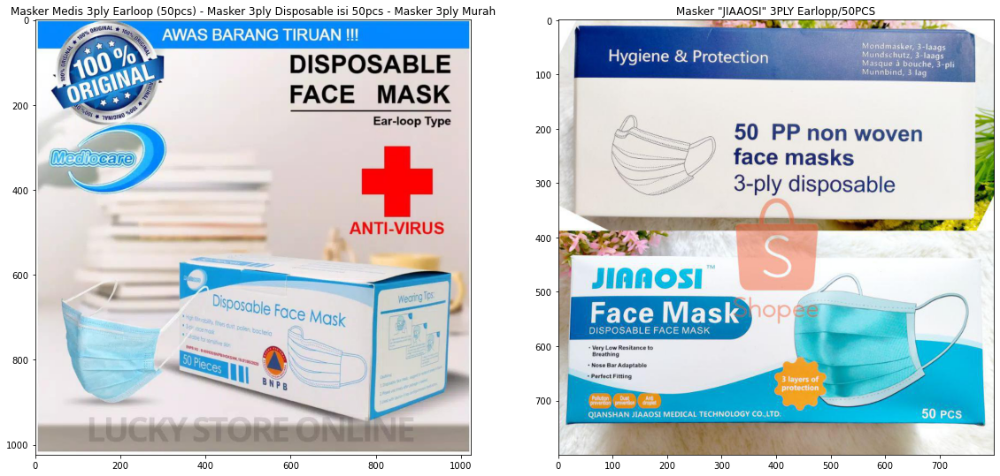

In [107]:
# Show matching images and titles of 'train_2905529497'
show_images_combined(train, 'train_2905529497', matches=True)

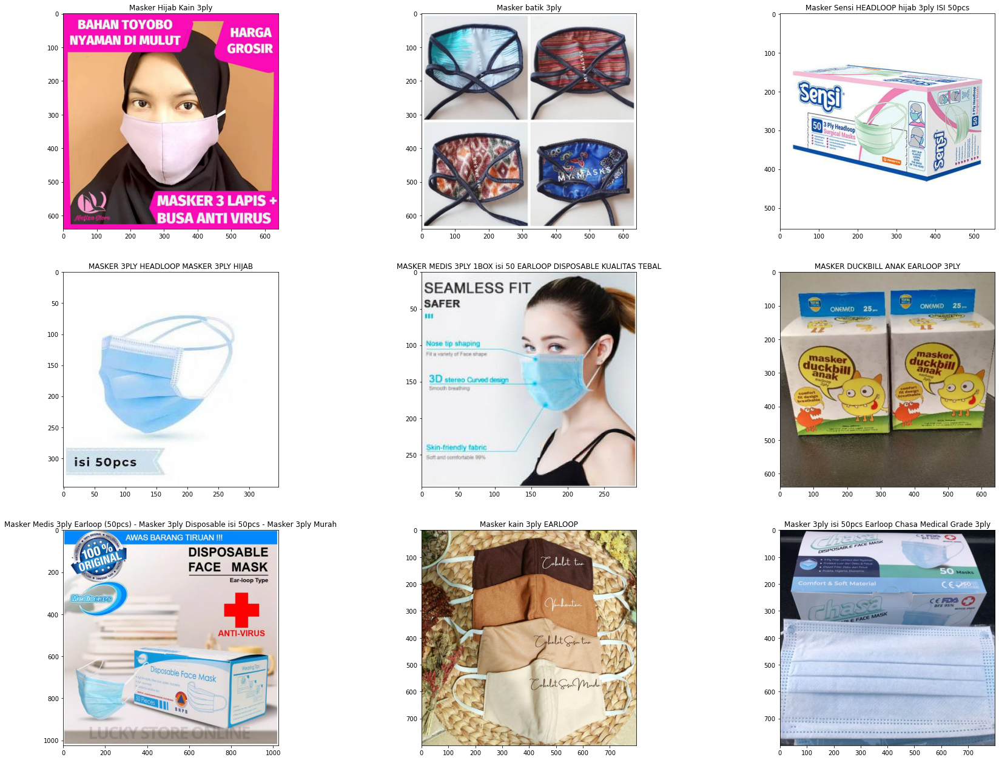

In [108]:
# Show predicted images and titles of 'train_2905529497' from model 0
show_images_combined(train, 'train_2905529497', model=0, matches=False)

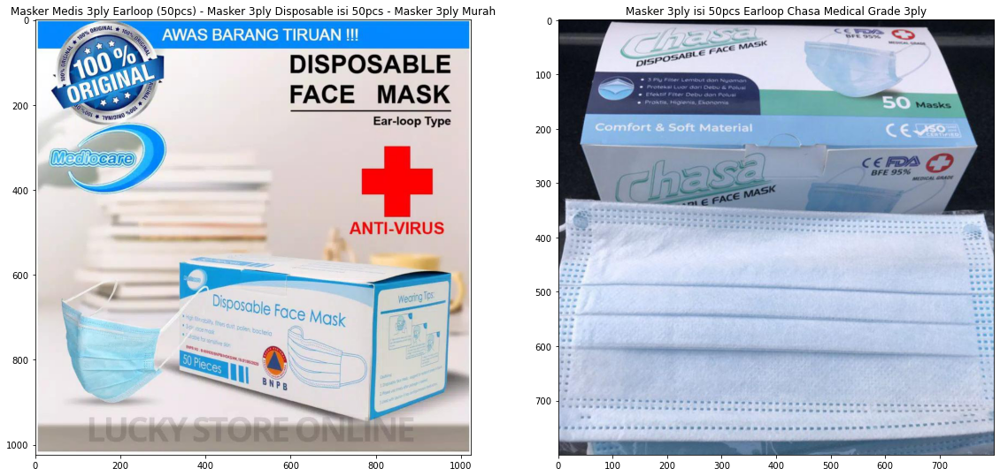

In [109]:
# Show predicted images and titles of 'train_2905529497' from model 1
show_images_combined(train, 'train_2905529497', model=1, matches=False)

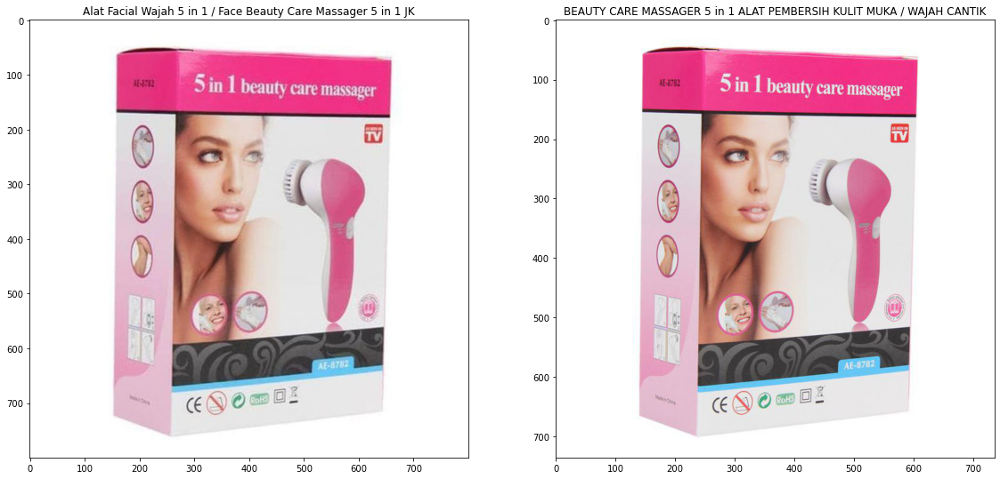

In [110]:
# Show matching images and titles of 'train_1461445798'
show_images_combined(train, 'train_1461445798', matches=True)

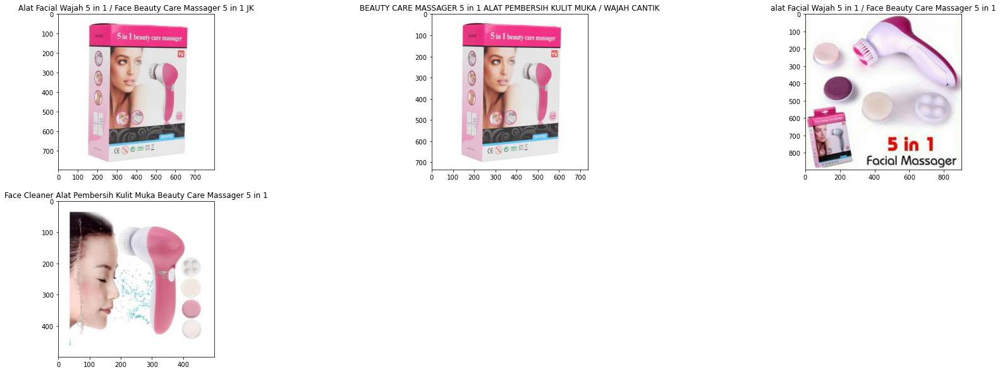

In [111]:
# Show predicted images and titles of 'train_1461445798' from model 0
show_images_combined(train, 'train_1461445798', model=0, matches=False)

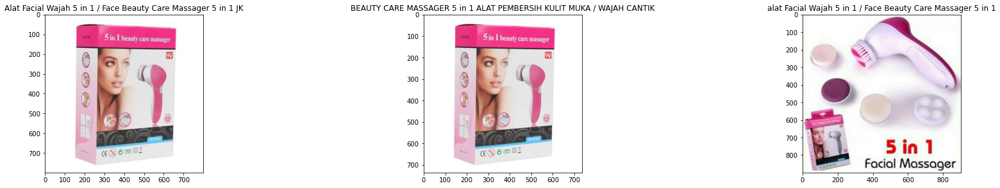

In [112]:
# Show predicted images and titles of 'train_1461445798' from model 1
show_images_combined(train, 'train_1461445798', model=1, matches=False)

#### Set Union Scores < Best Text Scores

There are some products where the set union scores are lower compared to the best text scores.

Examine these images / titles to see how we may retain the higher text scores.

In [113]:
# Locate predictions where set union is better than / equal to image but worse than text
train.loc[((train['combined_scores_0'] < train['best_text_scores_0']) & (train['combined_scores_0'] >= train['best_image_scores_0']) & \
           (train['combined_scores_1'] < train['best_text_scores_1']) & (train['combined_scores_1'] >= train['best_image_scores_1']))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
31,train_2410183091,B33F My Food Shop Shopping Trolley - ST. 003 t...,"[train_2410183091, train_2529718493, train_304...",[train_2410183091],"[train_143394667, train_1504499709, train_2410...",0.571429,"[train_143394667, train_1504499709, train_2410...",0.571429
64,train_3286978516,MIAO ANTICRACK / ANTI CRACK CASE FOR ALL TYPE ...,"[train_3286978516, train_782197349, train_1952...",[train_3286978516],"[train_285976786, train_3156194756, train_3286...",0.222222,"[train_285976786, train_3156194756, train_3286...",0.222222
93,train_1368113489,Wimiu BH Bra Menyusui Zemira BRM 1388,"[train_1368113489, train_1748623447]",[train_1368113489],"[train_1368113489, train_1748623447, train_265...",0.666667,"[train_1368113489, train_1748623447, train_265...",0.666667
152,train_3436013418,Pembalut Herbal AVAIL Merah/Pink Night Use (pe...,"[train_3436013418, train_1465256167, train_177...",[train_3436013418],"[train_1225835947, train_1507430363, train_173...",0.545455,"[train_1225835947, train_1507430363, train_173...",0.6
203,train_2482849092,ChinaTown - Timbangan Kopi Bumbu Dapur Emas Di...,"[train_2482849092, train_570997086]",[train_2482849092],"[train_1598259684, train_2482849092]",0.5,"[train_1598259684, train_2482849092, train_262...",0.4


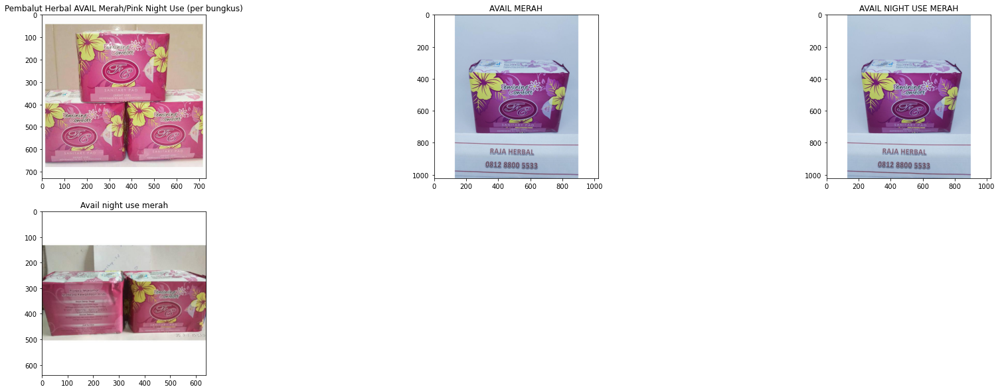

In [117]:
# Show matching images and titles of 'train_3436013418'
show_images_combined(train, 'train_3436013418', matches=True)

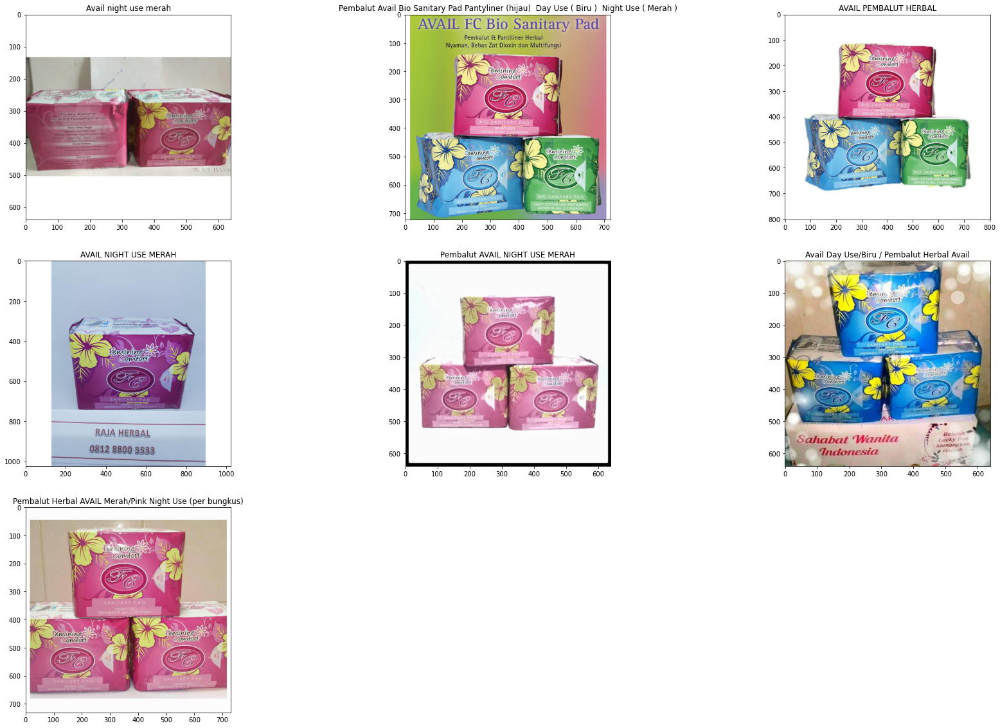

In [118]:
# Show predicted images and titles of 'train_3436013418' from model 0
show_images_combined(train, 'train_3436013418', model=0, matches=False)

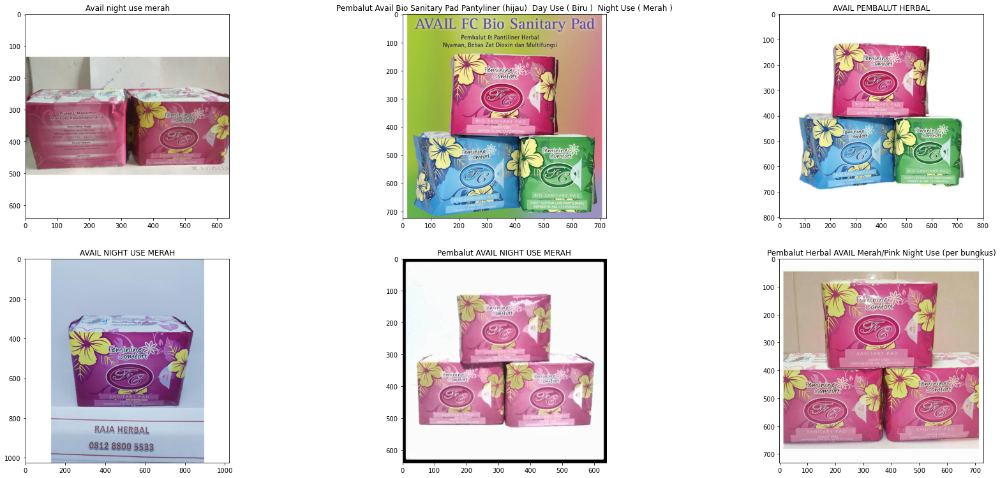

In [119]:
# Show predicted images and titles of 'train_3436013418' from model 1
show_images_combined(train, 'train_3436013418', model=1, matches=False)

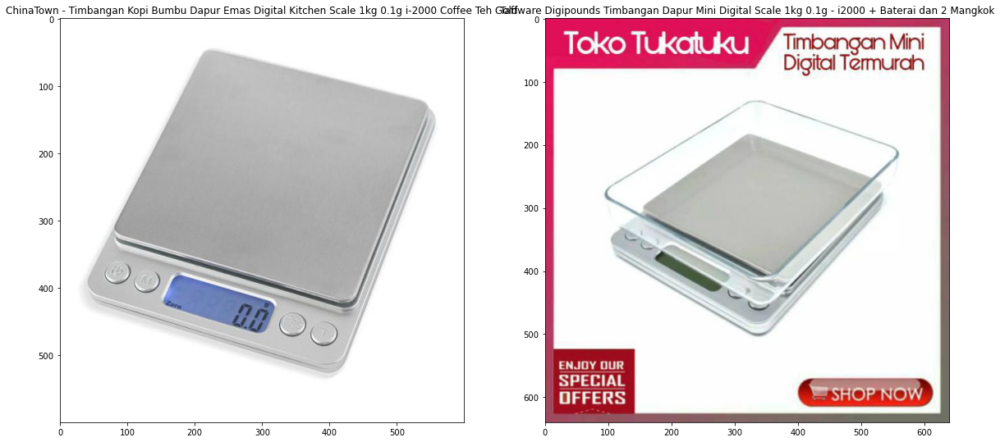

In [120]:
# Show matching images and titles of 'train_2482849092'
show_images_combined(train, 'train_2482849092', matches=True)

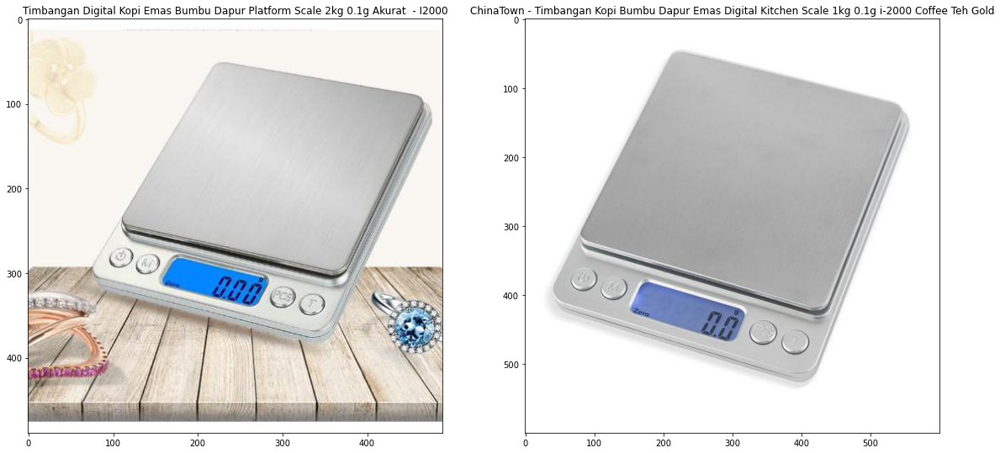

In [121]:
# Show predicted images and titles of 'train_2482849092' from model 0
show_images_combined(train, 'train_2482849092', model=0, matches=False)

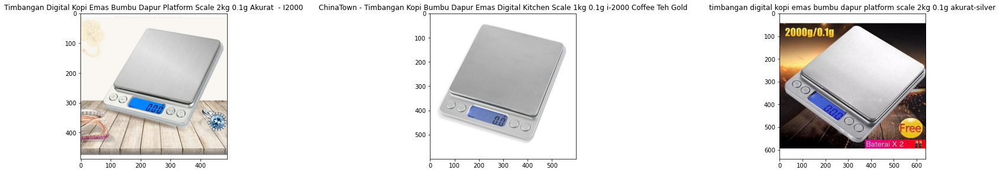

In [122]:
# Show predicted images and titles of 'train_2482849092' from model 1
show_images_combined(train, 'train_2482849092', model=1, matches=False)

#### F1 Scores = 0.5 or 0.4

After 1.0, 0.667, and 0.8, the next most frequent scores are 0.5 and 0.4.

Examine these images / titles to see how their scores may be improved.

In [123]:
# Locate predictions where combined score is 0.5
train.loc[((train['combined_scores_0'] == 0.5) & (train['combined_scores_1'] == 0.5))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
30,train_1617041019,Molina Kaftan / YADITA SPARKLE KAFTAN / KEANU ...,"[train_1617041019, train_2772927896]",[train_1617041019],"[train_1210102540, train_1617041019, train_176...",0.5,"[train_1210102540, train_1617041019, train_176...",0.5
49,train_3743764071,Aloevera kiloan gel aloe vera curah lidah buay...,"[train_3743764071, train_3172872581, train_238...",[train_3743764071],[train_3743764071],0.5,[train_3743764071],0.5
201,train_2495728489,KAIN STOKING POLOS / NYLON STOCKING FLOWER,"[train_2495728489, train_2892142848]",[train_2495728489],"[train_1321295918, train_2495728489]",0.5,"[train_1321295918, train_2495728489]",0.5
227,train_1680128704,PLAZA KOREA - KIMCHI SAWI FRESH 500GR - MAKANA...,"[train_1680128704, train_2826678027]",[train_1680128704],"[train_1680128704, train_2811705706]",0.5,"[train_1680128704, train_2811705706]",0.5
274,train_3697728683,11.11 SUPER BIGSALE \xe2\x80\x9cH-108\xe2\x80\...,"[train_3697728683, train_284207796]",[train_3697728683],"[train_2819377261, train_3697728683]",0.5,"[train_2819377261, train_3697728683]",0.5


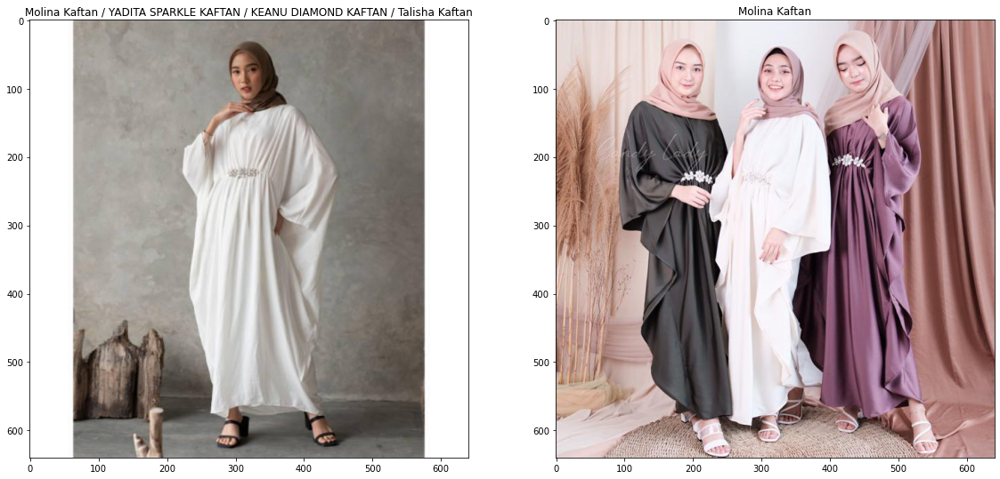

In [124]:
# Show matching images and titles of 'train_1617041019'
show_images_combined(train, 'train_1617041019', matches=True)

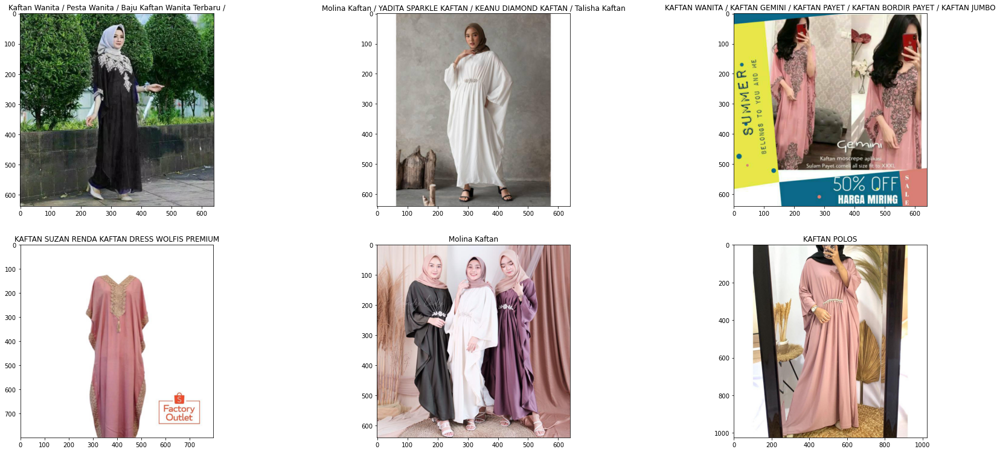

In [125]:
# Show predicted images and titles of 'train_1617041019' from model 0
show_images_combined(train, 'train_1617041019', model=0, matches=False)

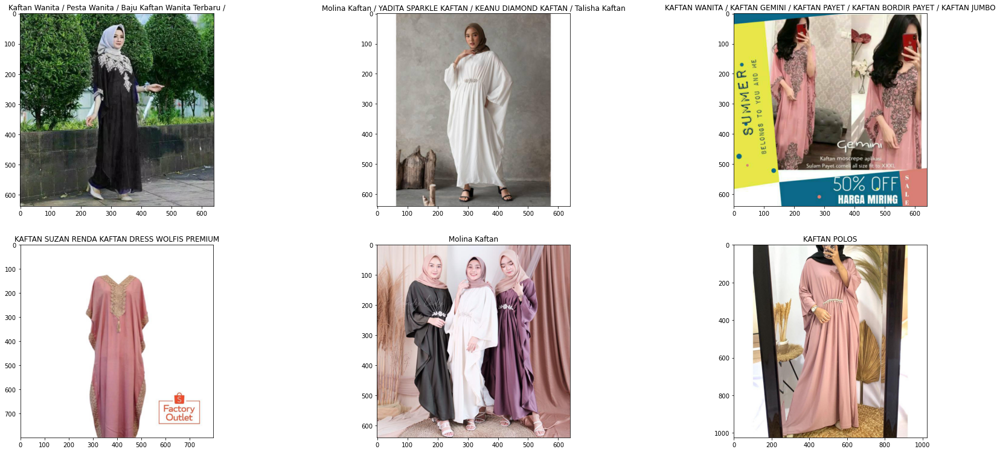

In [126]:
# Show predicted images and titles of 'train_1617041019' from model 1
show_images_combined(train, 'train_1617041019', model=1, matches=False)

In [127]:
# Locate predictions where combined score is 0.4
train.loc[((train['combined_scores_0'] == 0.4) & (train['combined_scores_1'] == 0.4))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
163,train_438033632,khusus live total 2 kg,"[train_438033632, train_4090578972, train_2029...",[train_438033632],[train_438033632],0.4,[train_438033632],0.4
175,train_2129499368,HANASUI Serum Gold Jaya Mandiri,"[train_2129499368, train_3594957739]",[train_2129499368],"[train_1713714671, train_1777649171, train_197...",0.4,"[train_1713714671, train_1777649171, train_197...",0.4
237,train_2117155561,Lampu Jamur / Lampu Tidur / Lampu Hias / Lampu...,"[train_2117155561, train_2799571415, train_321...",[train_2117155561],"[train_1007590256, train_1543675254, train_211...",0.4,"[train_2117155561, train_2374242484, train_321...",0.4
323,train_1894259571,Bebelove gold 2 700gr,"[train_1894259571, train_2403181438]",[train_1894259571],"[train_1894259571, train_2989309127, train_835...",0.4,"[train_1894259571, train_2989309127, train_835...",0.4
327,train_461752132,PP Lite Kertas Fotocopy A4 75gr - 1 Ream (500 ...,"[train_461752132, train_1908288077]",[train_461752132],"[train_1507351506, train_4022562985, train_461...",0.4,"[train_1507351506, train_4022562985, train_461...",0.4


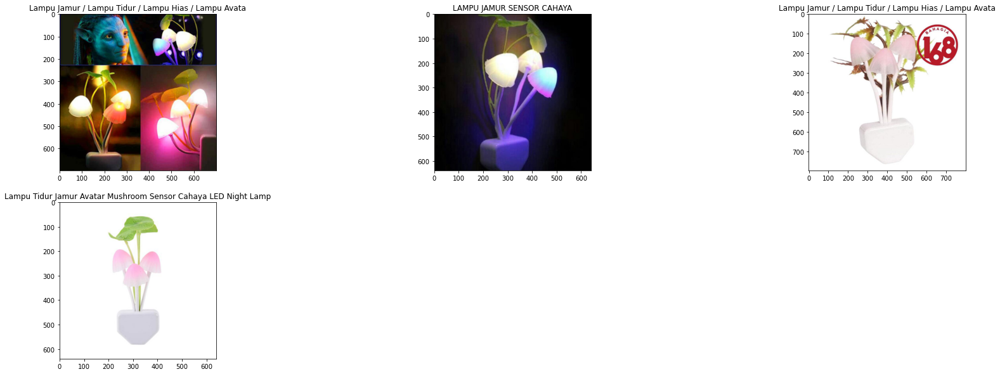

In [128]:
# Show matching images and titles of 'train_2117155561'
show_images_combined(train, 'train_2117155561', matches=True)

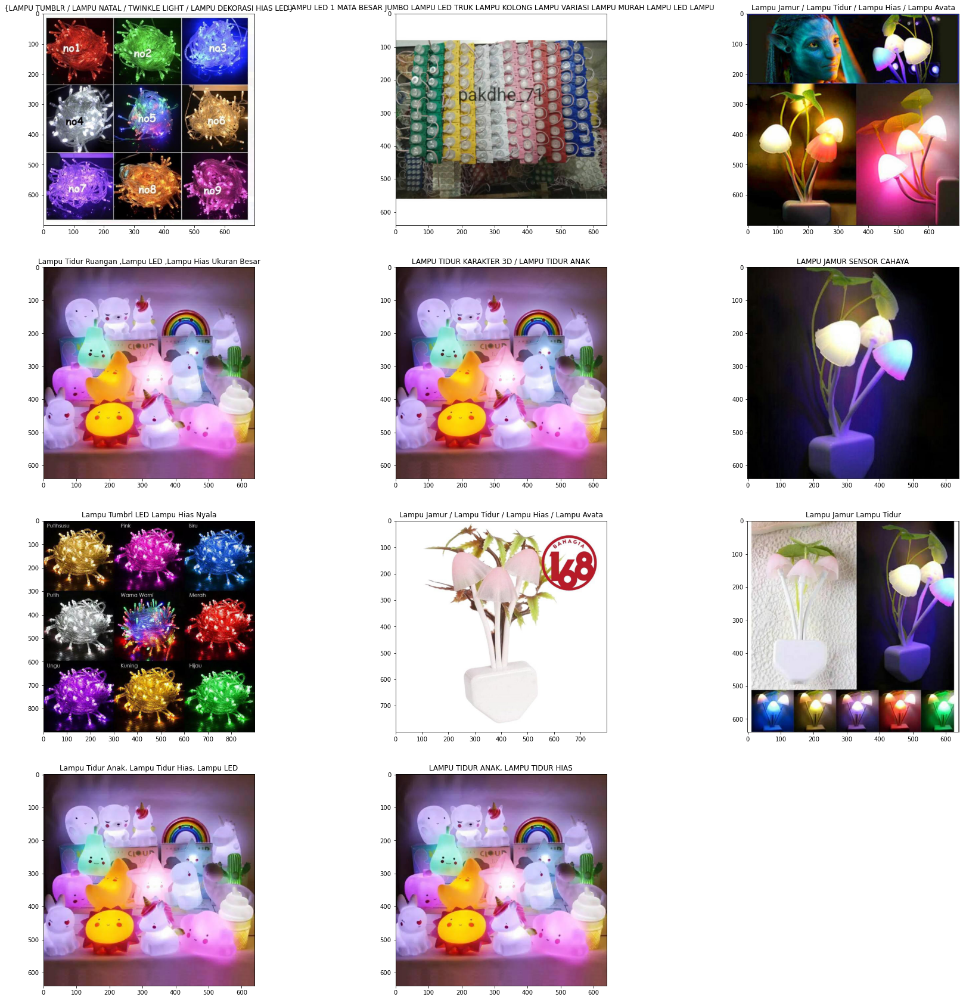

In [129]:
# Show predicted images and titles of 'train_2117155561' from model 0
show_images_combined(train, 'train_2117155561', model=0, matches=False)

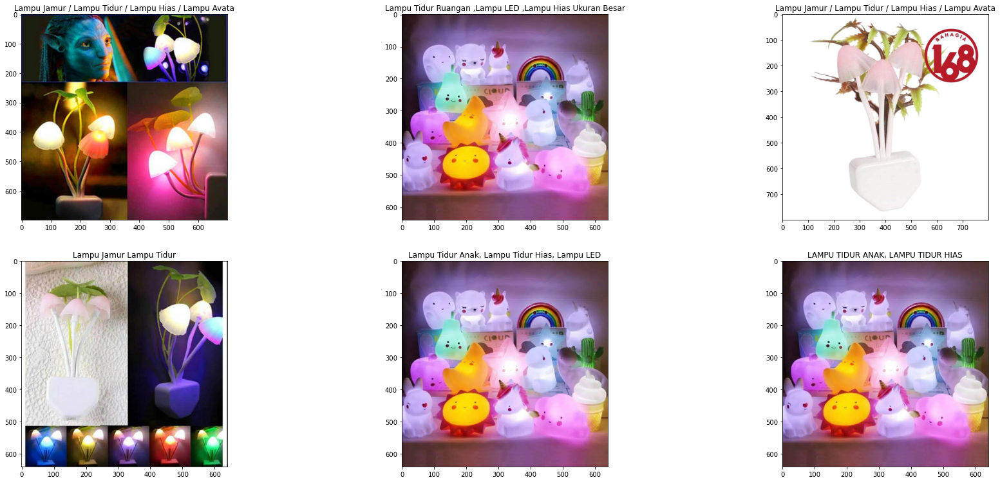

In [130]:
# Show predicted images and titles of 'train_2117155561' from model 1
show_images_combined(train, 'train_2117155561', model=1, matches=False)